In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os
from collections import OrderedDict

In [2]:
f_pred_dir = 'cell_type_classification/'
f_list = sorted(os.listdir(f_pred_dir))
f_list

['BIO_ddseq_1.FIXEDCELLS__cell_type_seurat.txt',
 'BIO_ddseq_2.FIXEDCELLS__cell_type_seurat.txt',
 'BIO_ddseq_3.FIXEDCELLS__cell_type_seurat.txt',
 'BIO_ddseq_4.FIXEDCELLS__cell_type_seurat.txt',
 'BRO_mtscatac_1.FIXEDCELLS__cell_type_seurat.txt',
 'BRO_mtscatac_2.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xmultiome_1.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xmultiome_2.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv11_1.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv11_2.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv11_3.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv11_4.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv11_5.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv2_1.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv2_2.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_hydrop_1.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_hydrop_2.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_hydrop_3.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_mtscatac_1.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_mtscatac_2.FIXEDCELLS__cell_type_s

In [3]:
ct_pred = {}
for f in f_list:
    k = f.split('__')[0]
    df = pd.read_csv(os.path.join(f_pred_dir, f), sep='\t')
    df['cell_type'] = df['cell_type'].replace('CD4+ T cell', 'Naive T cell')
    ct_pred[k] = df

In [4]:
alias_dict = OrderedDict({
    "Broad_1": "BioRad ATAC 1",
    "Broad_2": "BioRad ATAC 2",
    "Stanford_1": "10x ATAC A1",
    "Stanford_2": "10x ATAC A2",
    "VIB_1": "10x ATAC B1",
    "VIB_2": "10x ATAC B2",
    "CNAG_1": "10x ATAC C1",
    "CNAG_2": "10x ATAC C2",
    "Broad_mito_1": "10x mtATAC 1",
    "Broad_mito_2": "10x mtATAC 2",
    "Sanger_1": "10x Multiome 1",
    "Sanger_2": "10x Multiome 2",
    "VIB_Hydrop_1": "Hydrop ATAC 1",
    "VIB_Hydrop_2": "Hydrop ATAC 2",
    "s3atac": "s3 ATAC",
    # "merged": "Merged"
})

### Fraction of cells passing thresholds

In [6]:
def calc_frac_cells_passing_threshold(ct_pred, order, step=0.1):
    # calculate fraction of cells passing thresholds
    step = 0.05
    tmp = []
    auc = {}
    threshold_dict = {}
    for k,x in {key: ct_pred[key] for key in order}.items():

        thrs = np.arange(0,1+step,step)
        tmpdf = pd.DataFrame([
            thrs,
            [ sum(x['cell_type_pred_score'] >= thr) for thr in thrs ],
        ]).T
        tmpdf.columns = ['Threshold', 'Score']

        tmpdf['Score'] = tmpdf['Score']/x.shape[0]
        auc[k] = np.trapz(tmpdf['Score'].to_numpy(), x=tmpdf['Threshold'].to_numpy() )
        #tmpdf['Sample'] = k
        tmpdf['Sample'] = f"{k} ({round(auc[k],3)})"
        threshold_dict[k] = round(auc[k],3)
        tmp.append(tmpdf)
        #break
    tp = pd.concat(tmp, ignore_index=True)
    return tp, threshold_dict


def plot_frac_cells_passing_threshold(tp, ax, title="", leg_size=8,
                                      x='Threshold', y='Score',
                                      hue='Sample',
                                      style='Sample',
                                      palette='tab20',
                                      hue_order=None
                                     ):
    #dashes=[(''),(2,1)] * int(tp['Sample'].unique().size/2) + ['']
    n = tp['Sample'].unique().size
    if((n % 2) == 0):
        dashes=[(''),(2,1)] * int(n/2)
    else:
        dashes=[(''),(2,1)] * int(n/2) + ['']

    sns.lineplot(x=x, y=y,
                 hue=hue,
                 style=style,
                 dashes=dashes,
                 markers=True,
                 ax=ax,
                 palette=palette,
                 #size=0.8, #alpha=0.8,
                 lw=1,
                 data=tp,
                 hue_order=hue_order)
    ax.set_xlabel('Threshold on prediction score')
    ax.set_ylabel('Fraction of cells passing threshold')
    #plt.legend(bbox_to_anchor=(1.025, 1), loc=2, borderaxespad=0., fontsize=8)
    ax.grid(color='0.9')
    ax.legend(loc=3, fontsize=leg_size)
    ax.set_title(title)

In [7]:
# reorder legends function
import numpy as np
#  Returns tuple of handles, labels for axis ax, after reordering them to conform to the label order `order`, and if unique is True, after removing entries with duplicate labels.
def reorderLegend(ax=None,order=None,unique=False):
    if ax is None: ax=plt.gca()
    handles, labels = ax.get_legend_handles_labels()
    labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0])) # sort both labels and handles by labels
    if order is not None: # Sort according to a given list (not necessarily complete)
        keys=dict(zip(order,range(len(order))))
        labels, handles = zip(*sorted(zip(labels, handles), key=lambda t,keys=keys: keys.get(t[0],np.inf)))
    if unique:  labels, handles= zip(*unique_everseen(zip(labels,handles), key = labels)) # Keep only the first of each handle
    ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.) # i modified this line 

    return(handles, labels)


def unique_everseen(seq, key=None):
    seen = set()
    seen_add = seen.add
    return [x for x,k in zip(seq,key) if not (k in seen or seen_add(k))]

#source: https://stackoverflow.com/questions/22263807/how-is-order-of-items-in-matplotlib-legend-determined

In [8]:
order = [alias_dict[x] for x in alias_dict.keys()]

In [9]:
ct_pred.keys()

dict_keys(['BIO_ddseq_1.FIXEDCELLS', 'BIO_ddseq_2.FIXEDCELLS', 'BIO_ddseq_3.FIXEDCELLS', 'BIO_ddseq_4.FIXEDCELLS', 'BRO_mtscatac_1.FIXEDCELLS', 'BRO_mtscatac_2.FIXEDCELLS', 'CNA_10xmultiome_1.FIXEDCELLS', 'CNA_10xmultiome_2.FIXEDCELLS', 'CNA_10xv11_1.FIXEDCELLS', 'CNA_10xv11_2.FIXEDCELLS', 'CNA_10xv11_3.FIXEDCELLS', 'CNA_10xv11_4.FIXEDCELLS', 'CNA_10xv11_5.FIXEDCELLS', 'CNA_10xv2_1.FIXEDCELLS', 'CNA_10xv2_2.FIXEDCELLS', 'CNA_hydrop_1.FIXEDCELLS', 'CNA_hydrop_2.FIXEDCELLS', 'CNA_hydrop_3.FIXEDCELLS', 'CNA_mtscatac_1.FIXEDCELLS', 'CNA_mtscatac_2.FIXEDCELLS', 'EPF_hydrop_1.FIXEDCELLS', 'EPF_hydrop_2.FIXEDCELLS', 'EPF_hydrop_3.FIXEDCELLS', 'EPF_hydrop_4.FIXEDCELLS', 'HAR_ddseq_1.FIXEDCELLS', 'HAR_ddseq_2.FIXEDCELLS', 'MDC_mtscatac_1.FIXEDCELLS', 'MDC_mtscatac_2.FIXEDCELLS', 'OHS_s3atac_1.FIXEDCELLS', 'OHS_s3atac_2.FIXEDCELLS', 'SAN_10xmultiome_1.FIXEDCELLS', 'SAN_10xmultiome_2.FIXEDCELLS', 'STA_10xv11_1.FIXEDCELLS', 'STA_10xv11_2.FIXEDCELLS', 'TXG_10xv11_1.FIXEDCELLS', 'TXG_10xv2_1.FIXEDCE

In [10]:
tp, threshold_dict = calc_frac_cells_passing_threshold(ct_pred, order=ct_pred.keys(), step=0.1)

In [11]:
threshold_dict

{'BIO_ddseq_1.FIXEDCELLS': 0.695,
 'BIO_ddseq_2.FIXEDCELLS': 0.747,
 'BIO_ddseq_3.FIXEDCELLS': 0.751,
 'BIO_ddseq_4.FIXEDCELLS': 0.772,
 'BRO_mtscatac_1.FIXEDCELLS': 0.833,
 'BRO_mtscatac_2.FIXEDCELLS': 0.821,
 'CNA_10xmultiome_1.FIXEDCELLS': 0.766,
 'CNA_10xmultiome_2.FIXEDCELLS': 0.709,
 'CNA_10xv11_1.FIXEDCELLS': 0.795,
 'CNA_10xv11_2.FIXEDCELLS': 0.784,
 'CNA_10xv11_3.FIXEDCELLS': 0.796,
 'CNA_10xv11_4.FIXEDCELLS': 0.765,
 'CNA_10xv11_5.FIXEDCELLS': 0.803,
 'CNA_10xv2_1.FIXEDCELLS': 0.784,
 'CNA_10xv2_2.FIXEDCELLS': 0.78,
 'CNA_hydrop_1.FIXEDCELLS': 0.47,
 'CNA_hydrop_2.FIXEDCELLS': 0.509,
 'CNA_hydrop_3.FIXEDCELLS': 0.506,
 'CNA_mtscatac_1.FIXEDCELLS': 0.695,
 'CNA_mtscatac_2.FIXEDCELLS': 0.686,
 'EPF_hydrop_1.FIXEDCELLS': 0.662,
 'EPF_hydrop_2.FIXEDCELLS': 0.613,
 'EPF_hydrop_3.FIXEDCELLS': 0.663,
 'EPF_hydrop_4.FIXEDCELLS': 0.658,
 'HAR_ddseq_1.FIXEDCELLS': 0.784,
 'HAR_ddseq_2.FIXEDCELLS': 0.752,
 'MDC_mtscatac_1.FIXEDCELLS': 0.757,
 'MDC_mtscatac_2.FIXEDCELLS': 0.667,
 'OHS_s3

# NOTE: the samples will be dislpayed in the order of this dict!
color_dict = OrderedDict({
    "BioRad ATAC 1": "#1f77b4",
    "BioRad ATAC 2": "#aec7e8",
    "10x ATAC A1": "#ff7f0e",
    "10x ATAC A2": "#ffbb78",
    "10x ATAC B1": "#2ca02c",
    "10x ATAC B2": "#98df8a",
    "10x ATAC C1": "#d62728",
    "10x ATAC C2": "#ff9896",
    "10x mtATAC 1": "#9467bd",
    "10x mtATAC 2": "#c5b0d5",
    "10x Multiome 1": "#8c564b",
    "10x Multiome 2": "#c49c94",
    "Hydrop ATAC 1": "#e377c2",
    "Hydrop ATAC 2": "#f7b6d2",
    "s3 ATAC": "#7f7f7f",
    # "Merged": "#111111"
})

In [12]:
color = "#1f77b4"
color_dict = {key: color for key in ct_pred.keys()}

In [13]:
color_dict_thr = {}
for x in color_dict.keys():
    color_dict_thr[x + ' (' + str(threshold_dict[x]) + ')'] = color_dict[x]

In [14]:
sorted(list(color_dict_thr.keys()))

['BIO_ddseq_1.FIXEDCELLS (0.695)',
 'BIO_ddseq_2.FIXEDCELLS (0.747)',
 'BIO_ddseq_3.FIXEDCELLS (0.751)',
 'BIO_ddseq_4.FIXEDCELLS (0.772)',
 'BRO_mtscatac_1.FIXEDCELLS (0.833)',
 'BRO_mtscatac_2.FIXEDCELLS (0.821)',
 'CNA_10xmultiome_1.FIXEDCELLS (0.766)',
 'CNA_10xmultiome_2.FIXEDCELLS (0.709)',
 'CNA_10xv11_1.FIXEDCELLS (0.795)',
 'CNA_10xv11_2.FIXEDCELLS (0.784)',
 'CNA_10xv11_3.FIXEDCELLS (0.796)',
 'CNA_10xv11_4.FIXEDCELLS (0.765)',
 'CNA_10xv11_5.FIXEDCELLS (0.803)',
 'CNA_10xv2_1.FIXEDCELLS (0.784)',
 'CNA_10xv2_2.FIXEDCELLS (0.78)',
 'CNA_hydrop_1.FIXEDCELLS (0.47)',
 'CNA_hydrop_2.FIXEDCELLS (0.509)',
 'CNA_hydrop_3.FIXEDCELLS (0.506)',
 'CNA_mtscatac_1.FIXEDCELLS (0.695)',
 'CNA_mtscatac_2.FIXEDCELLS (0.686)',
 'EPF_hydrop_1.FIXEDCELLS (0.662)',
 'EPF_hydrop_2.FIXEDCELLS (0.613)',
 'EPF_hydrop_3.FIXEDCELLS (0.663)',
 'EPF_hydrop_4.FIXEDCELLS (0.658)',
 'HAR_ddseq_1.FIXEDCELLS (0.784)',
 'HAR_ddseq_2.FIXEDCELLS (0.752)',
 'MDC_mtscatac_1.FIXEDCELLS (0.757)',
 'MDC_mtscatac_2.F

In [15]:
sorted(list(color_dict_thr.keys()))

['BIO_ddseq_1.FIXEDCELLS (0.695)',
 'BIO_ddseq_2.FIXEDCELLS (0.747)',
 'BIO_ddseq_3.FIXEDCELLS (0.751)',
 'BIO_ddseq_4.FIXEDCELLS (0.772)',
 'BRO_mtscatac_1.FIXEDCELLS (0.833)',
 'BRO_mtscatac_2.FIXEDCELLS (0.821)',
 'CNA_10xmultiome_1.FIXEDCELLS (0.766)',
 'CNA_10xmultiome_2.FIXEDCELLS (0.709)',
 'CNA_10xv11_1.FIXEDCELLS (0.795)',
 'CNA_10xv11_2.FIXEDCELLS (0.784)',
 'CNA_10xv11_3.FIXEDCELLS (0.796)',
 'CNA_10xv11_4.FIXEDCELLS (0.765)',
 'CNA_10xv11_5.FIXEDCELLS (0.803)',
 'CNA_10xv2_1.FIXEDCELLS (0.784)',
 'CNA_10xv2_2.FIXEDCELLS (0.78)',
 'CNA_hydrop_1.FIXEDCELLS (0.47)',
 'CNA_hydrop_2.FIXEDCELLS (0.509)',
 'CNA_hydrop_3.FIXEDCELLS (0.506)',
 'CNA_mtscatac_1.FIXEDCELLS (0.695)',
 'CNA_mtscatac_2.FIXEDCELLS (0.686)',
 'EPF_hydrop_1.FIXEDCELLS (0.662)',
 'EPF_hydrop_2.FIXEDCELLS (0.613)',
 'EPF_hydrop_3.FIXEDCELLS (0.663)',
 'EPF_hydrop_4.FIXEDCELLS (0.658)',
 'HAR_ddseq_1.FIXEDCELLS (0.784)',
 'HAR_ddseq_2.FIXEDCELLS (0.752)',
 'MDC_mtscatac_1.FIXEDCELLS (0.757)',
 'MDC_mtscatac_2.F

In [16]:
order_thr = color_dict_thr.keys()

In [17]:
tp['tech'] = [x.split('_')[1] for x in tp['Sample']]

In [18]:
tp

,Threshold,Score,Sample,tech
0,0.00,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq
1,0.05,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq
2,0.10,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq
3,0.15,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq
4,0.20,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq
...,...,...,...,...
1003,0.80,0.157002,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop
1004,0.85,0.108850,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop
1005,0.90,0.060699,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop
1006,0.95,0.030180,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop


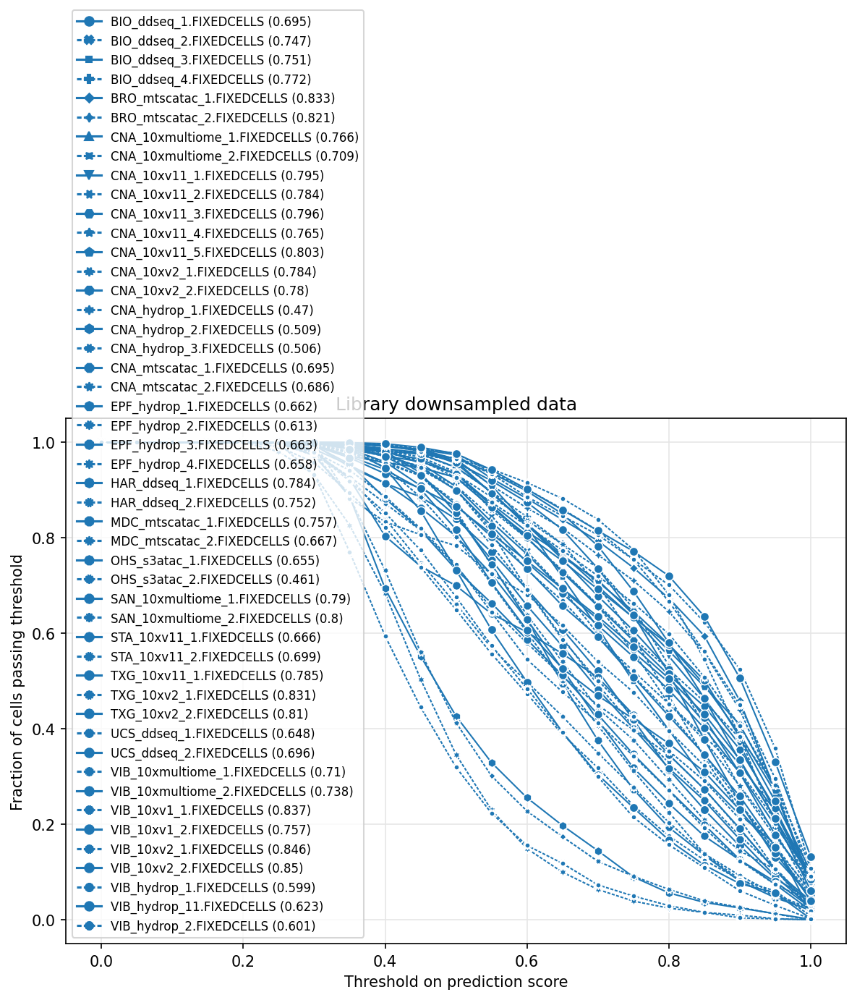

In [19]:
fig, ax = plt.subplots(1,1, figsize=(8,8), dpi=150 )
plot_frac_cells_passing_threshold(tp, ax, title="Library downsampled data", palette=color_dict_thr)
# plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.tight_layout()
# reorderLegend(ax, order_thr)
tp['Dataset'] = "Library downsampled data"
# plt_pred['Libds'] = tp.copy()
# plt.savefig(f'plts_pub/libds_label_transfer.png', transparent=False, bbox_inches='tight', facecolor='white', dpi=300)
# plt.savefig(f'plts_pub/libds_label_transfer.svg', transparent=False, bbox_inches='tight', facecolor='white', dpi=300)

In [20]:
sorted(tp['Sample'].unique())

['BIO_ddseq_1.FIXEDCELLS (0.695)',
 'BIO_ddseq_2.FIXEDCELLS (0.747)',
 'BIO_ddseq_3.FIXEDCELLS (0.751)',
 'BIO_ddseq_4.FIXEDCELLS (0.772)',
 'BRO_mtscatac_1.FIXEDCELLS (0.833)',
 'BRO_mtscatac_2.FIXEDCELLS (0.821)',
 'CNA_10xmultiome_1.FIXEDCELLS (0.766)',
 'CNA_10xmultiome_2.FIXEDCELLS (0.709)',
 'CNA_10xv11_1.FIXEDCELLS (0.795)',
 'CNA_10xv11_2.FIXEDCELLS (0.784)',
 'CNA_10xv11_3.FIXEDCELLS (0.796)',
 'CNA_10xv11_4.FIXEDCELLS (0.765)',
 'CNA_10xv11_5.FIXEDCELLS (0.803)',
 'CNA_10xv2_1.FIXEDCELLS (0.784)',
 'CNA_10xv2_2.FIXEDCELLS (0.78)',
 'CNA_hydrop_1.FIXEDCELLS (0.47)',
 'CNA_hydrop_2.FIXEDCELLS (0.509)',
 'CNA_hydrop_3.FIXEDCELLS (0.506)',
 'CNA_mtscatac_1.FIXEDCELLS (0.695)',
 'CNA_mtscatac_2.FIXEDCELLS (0.686)',
 'EPF_hydrop_1.FIXEDCELLS (0.662)',
 'EPF_hydrop_2.FIXEDCELLS (0.613)',
 'EPF_hydrop_3.FIXEDCELLS (0.663)',
 'EPF_hydrop_4.FIXEDCELLS (0.658)',
 'HAR_ddseq_1.FIXEDCELLS (0.784)',
 'HAR_ddseq_2.FIXEDCELLS (0.752)',
 'MDC_mtscatac_1.FIXEDCELLS (0.757)',
 'MDC_mtscatac_2.F

ddseq


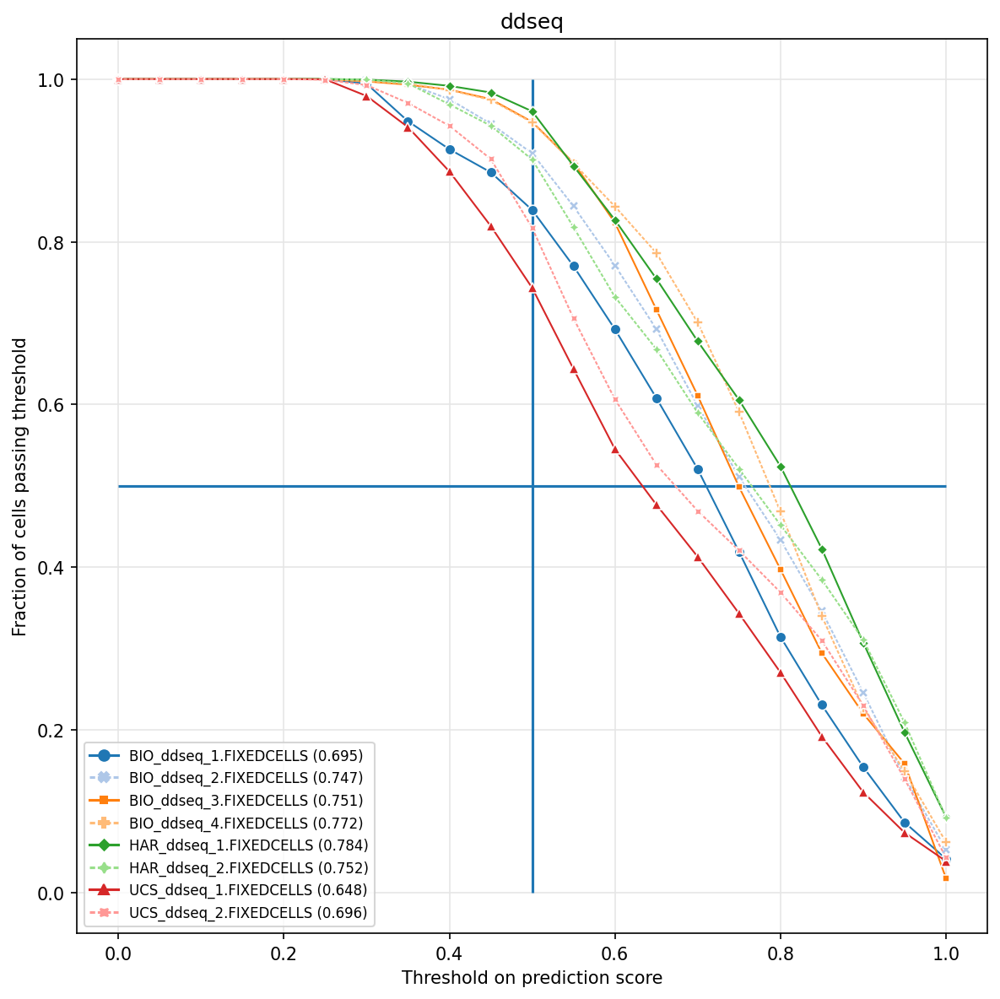

mtscatac


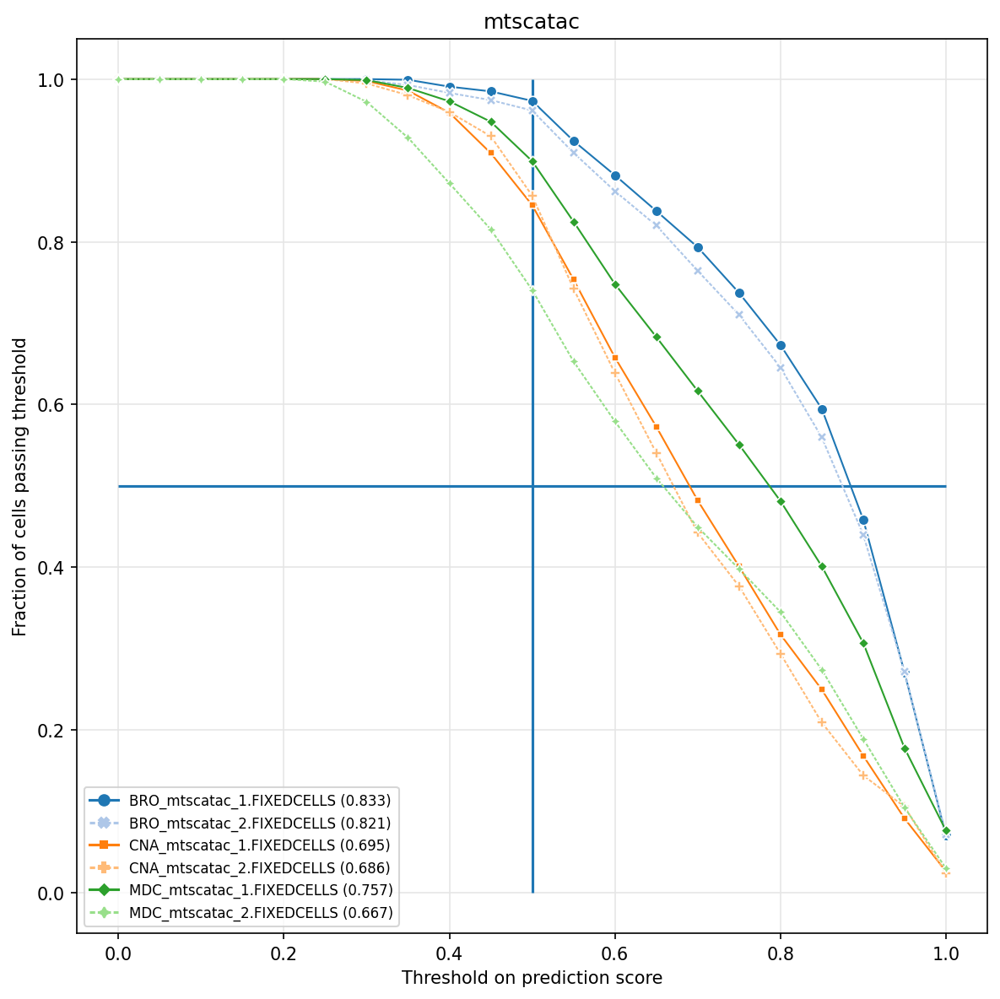

10xmultiome


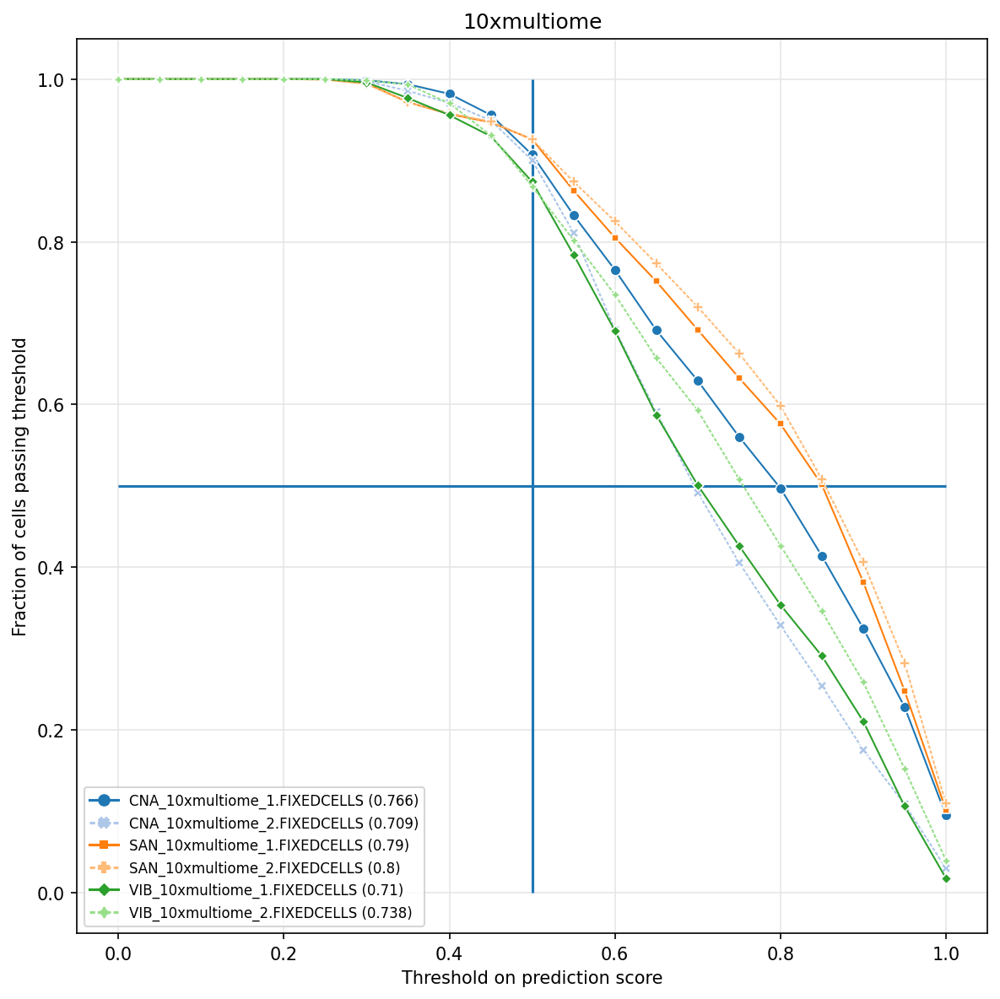

10xv11


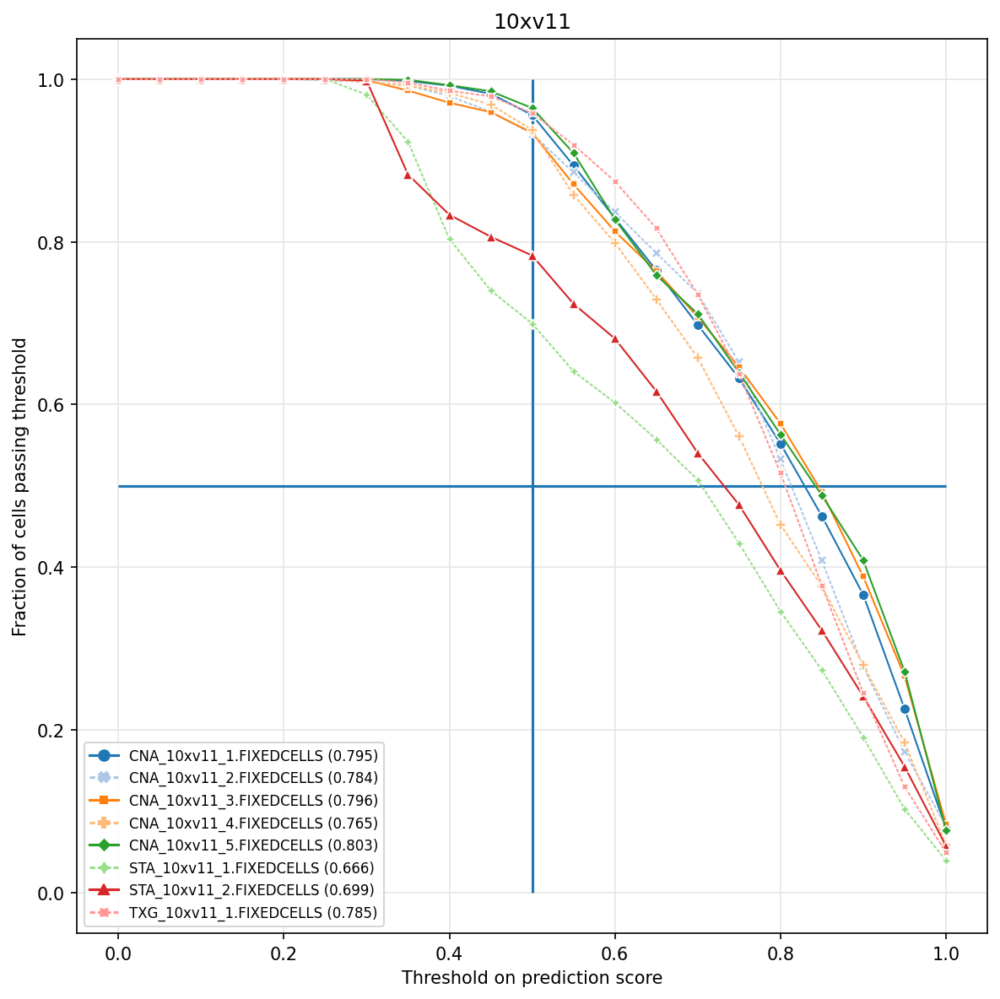

10xv2


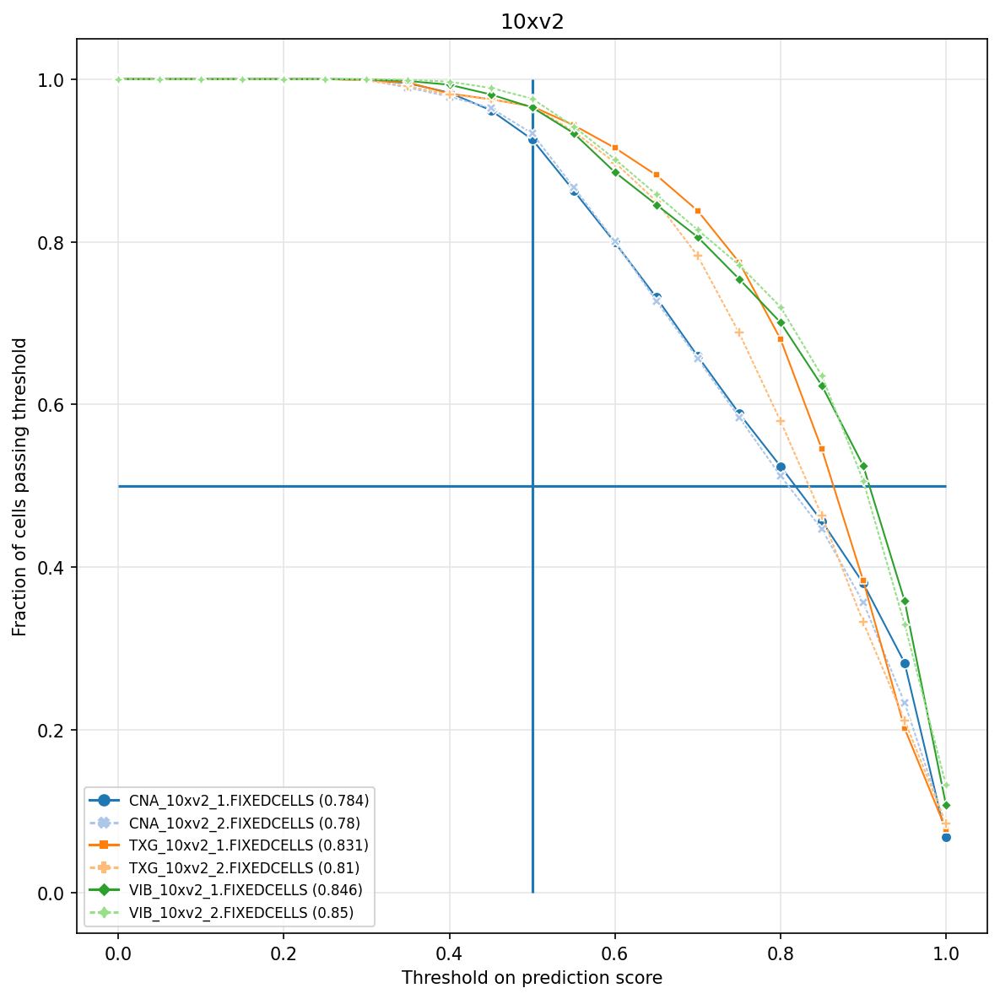

hydrop


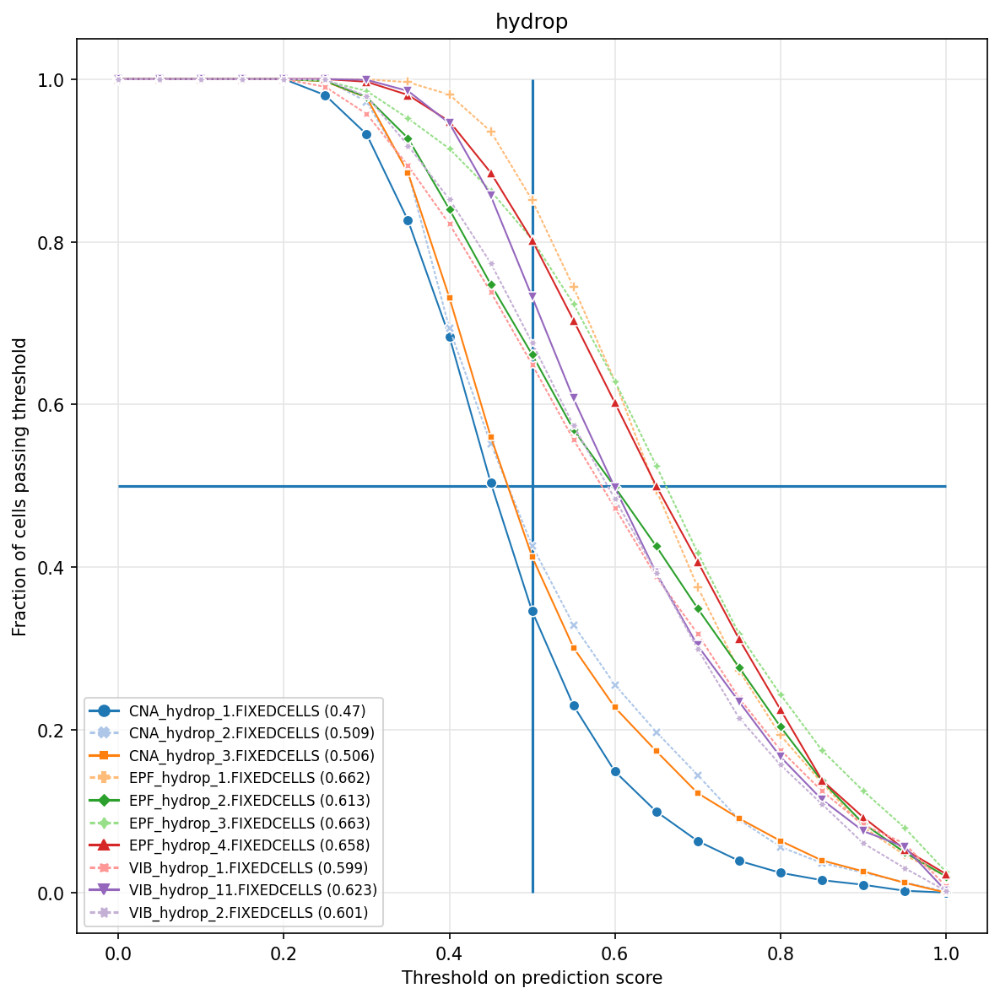

s3atac


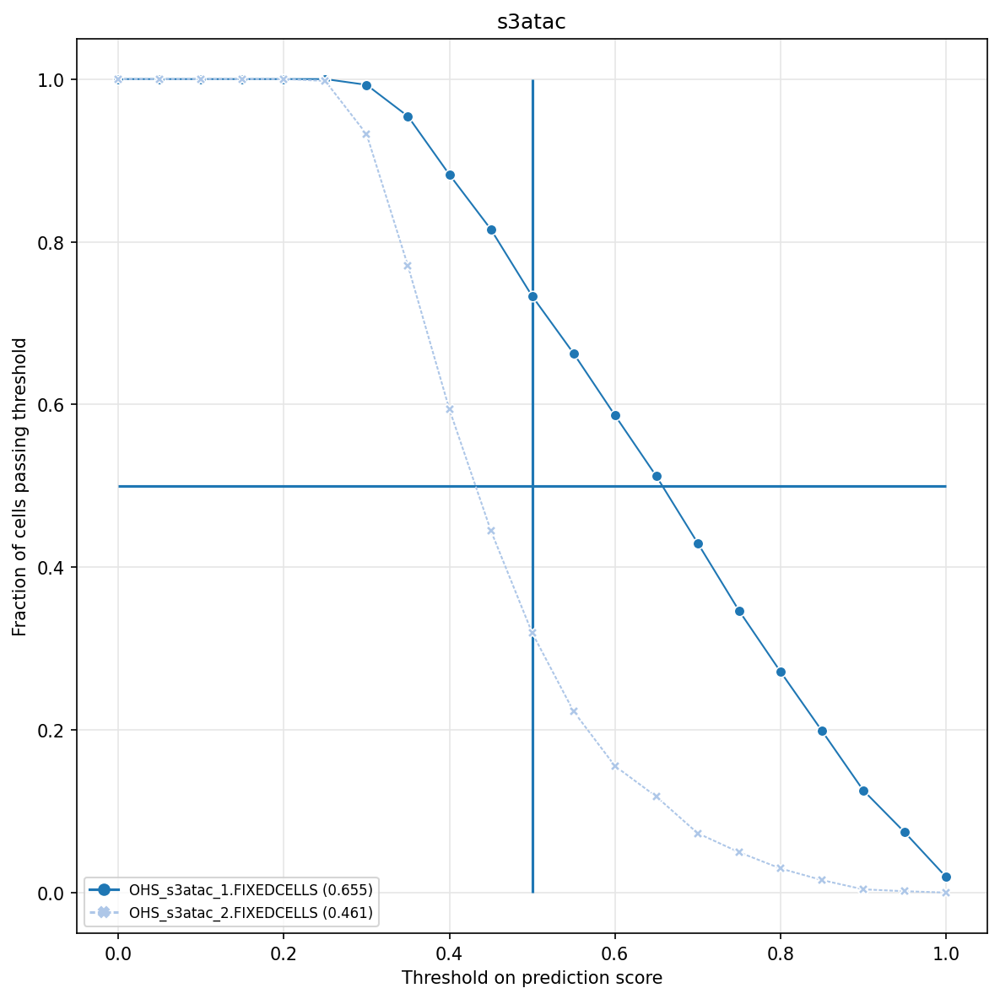

10xv1


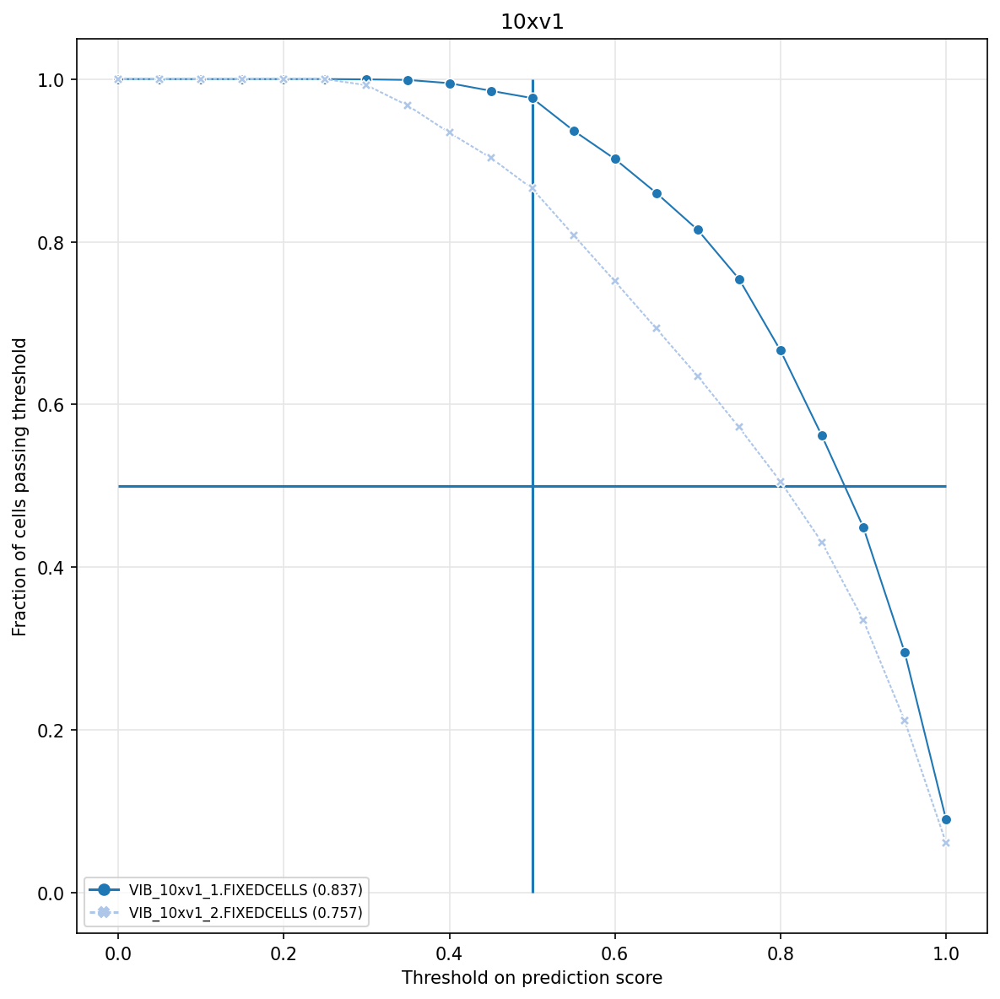

In [21]:
for tech in tp['tech'].unique():
    print(tech)
    tp_sub = tp[tp['tech'] == tech]
    
    fig, ax = plt.subplots(1,1, figsize=(8,8), dpi=150)
    order = sorted(tp_sub['Sample'].unique())
    ax.vlines(x=0.5, ymin=0, ymax=1)
    ax.hlines(y=0.5, xmin=0, xmax=1)

    plot_frac_cells_passing_threshold(tp_sub, ax, title=tech, hue_order=order)
    # plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

    plt.tight_layout()
    plt.show()
    plt.close()

In [22]:
tp

,Threshold,Score,Sample,tech,Dataset
0,0.00,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data
1,0.05,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data
2,0.10,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data
3,0.15,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data
4,0.20,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data
...,...,...,...,...,...
1003,0.80,0.157002,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop,Library downsampled data
1004,0.85,0.108850,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop,Library downsampled data
1005,0.90,0.060699,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop,Library downsampled data
1006,0.95,0.030180,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop,Library downsampled data


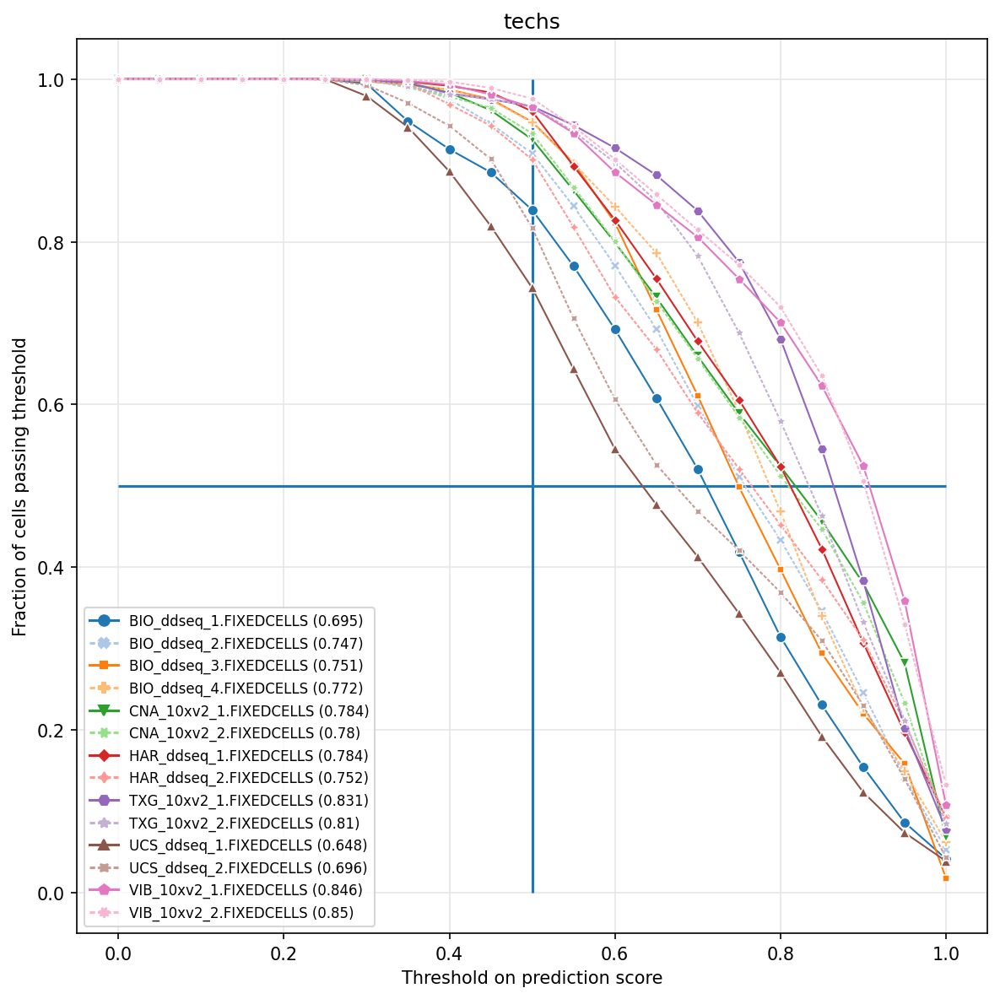

In [23]:
tech_list = ['ddseq', '10xv2']
tp_sub = pd.DataFrame()
tp_sub_sub = pd.DataFrame()
for tech in tech_list:
    tp_sub_sub = tp[tp['tech'] == tech]
    tp_sub = pd.concat([tp_sub, tp_sub_sub])

fig, ax = plt.subplots(1,1, figsize=(8,8), dpi=150)
order = sorted(tp_sub['Sample'].unique())
ax.vlines(x=0.5, ymin=0, ymax=1)
ax.hlines(y=0.5, xmin=0, xmax=1)

plot_frac_cells_passing_threshold(tp_sub, ax, title='techs', hue_order=order)
# plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.tight_layout()
plt.show()
plt.close()

# Per technique

In [24]:
tp['sample_old'] = [x.split(' ')[0] for x in tp['Sample']]
tp['tech'] = [x.split('_')[1] for x in tp['sample_old']]

tp

,Threshold,Score,Sample,tech,Dataset,sample_old
0,0.00,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data,BIO_ddseq_1.FIXEDCELLS
1,0.05,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data,BIO_ddseq_1.FIXEDCELLS
2,0.10,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data,BIO_ddseq_1.FIXEDCELLS
3,0.15,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data,BIO_ddseq_1.FIXEDCELLS
4,0.20,1.000000,BIO_ddseq_1.FIXEDCELLS (0.695),ddseq,Library downsampled data,BIO_ddseq_1.FIXEDCELLS
...,...,...,...,...,...,...
1003,0.80,0.157002,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop,Library downsampled data,VIB_hydrop_2.FIXEDCELLS
1004,0.85,0.108850,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop,Library downsampled data,VIB_hydrop_2.FIXEDCELLS
1005,0.90,0.060699,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop,Library downsampled data,VIB_hydrop_2.FIXEDCELLS
1006,0.95,0.030180,VIB_hydrop_2.FIXEDCELLS (0.601),hydrop,Library downsampled data,VIB_hydrop_2.FIXEDCELLS


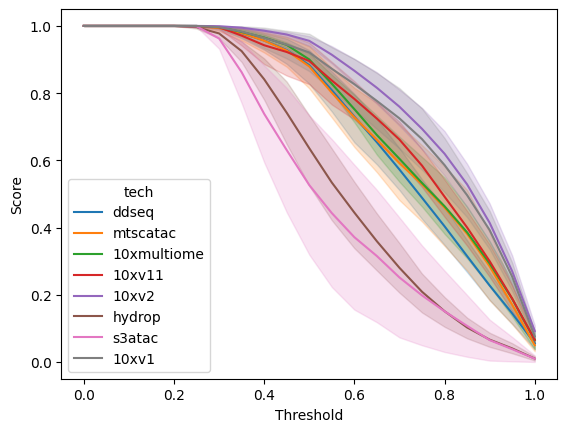

In [25]:
sns.lineplot(
    x="Threshold",
    y="Score",
    hue="tech",
    data=tp,
)
plt.savefig('plots_pub/seurat_scores_bytech.png', facecolor='white', dpi=300)

# ROC curve per cell type

In [26]:
# cell_palette = {x: sns.color_palette('tab10')[list(df['cell_type'].unique()).index(x)] for x in sorted(df['cell_type'].unique())}

In [27]:
cell_palette = {
    'B cell': (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
    'CD14+ monocyte': (0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
    'CD16+ monocyte': (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
    'Naive T cell': (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
    'Cytotoxic T cell': (1.0, 0.4980392156862745, 0.054901960784313725),
    'Dendritic cell': (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
    'Natural killer cell': (0.5490196078431373, 0.33725490196078434, 0.29411764705882354)
}

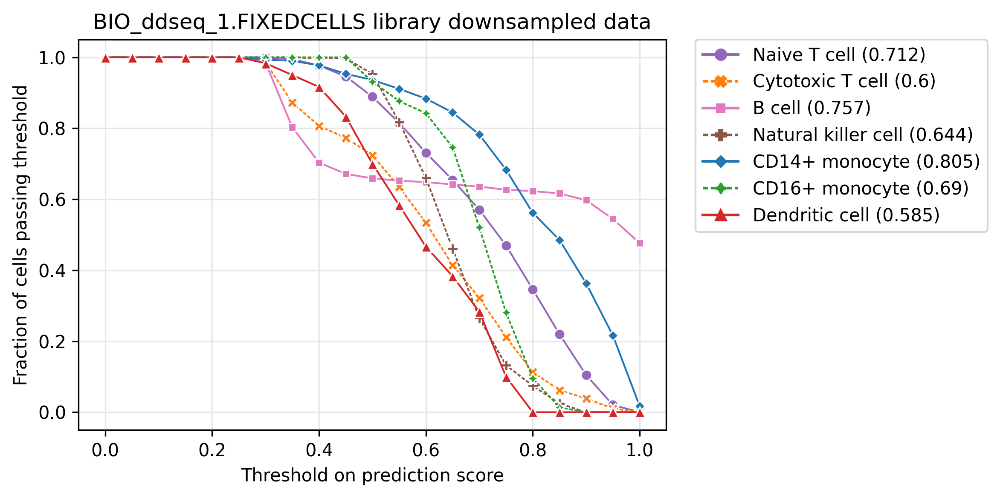

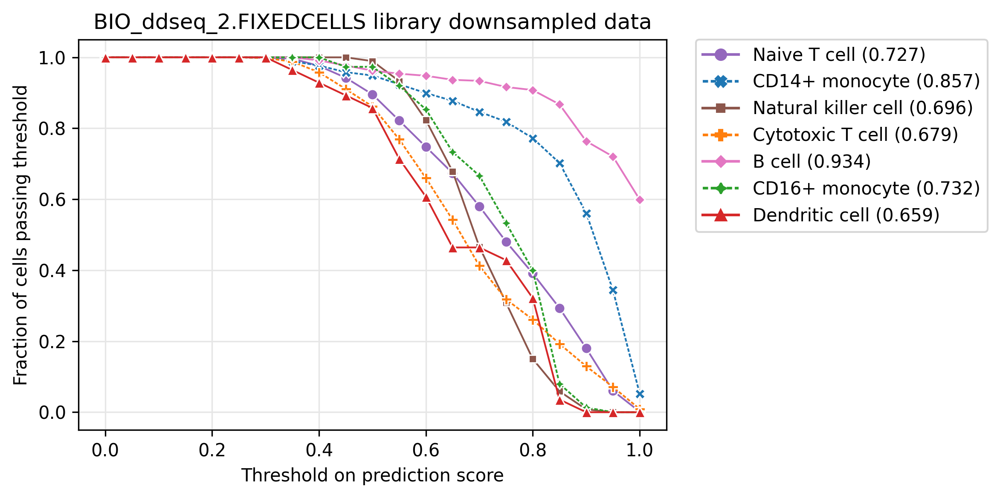

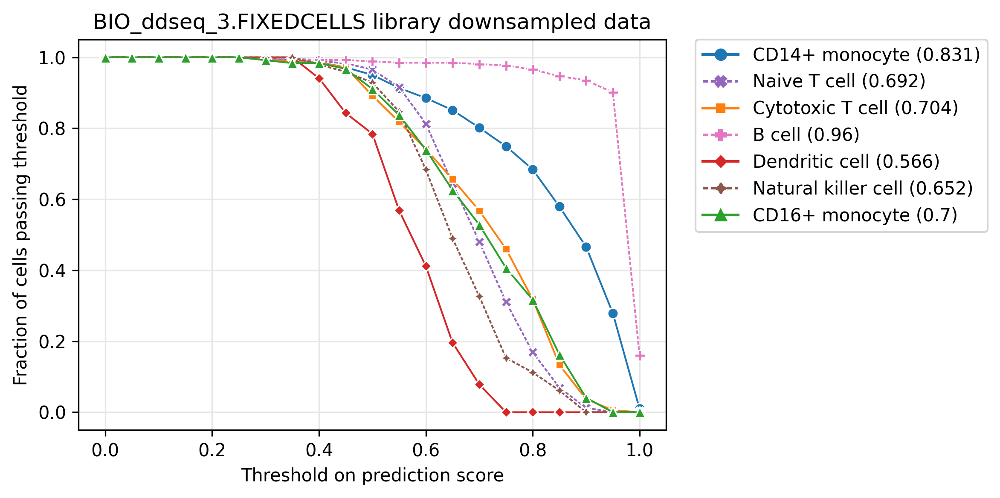

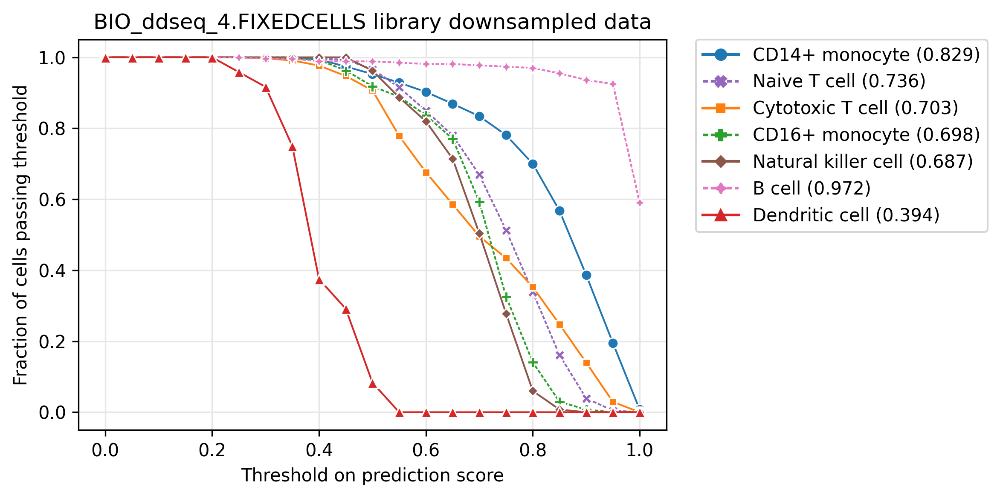

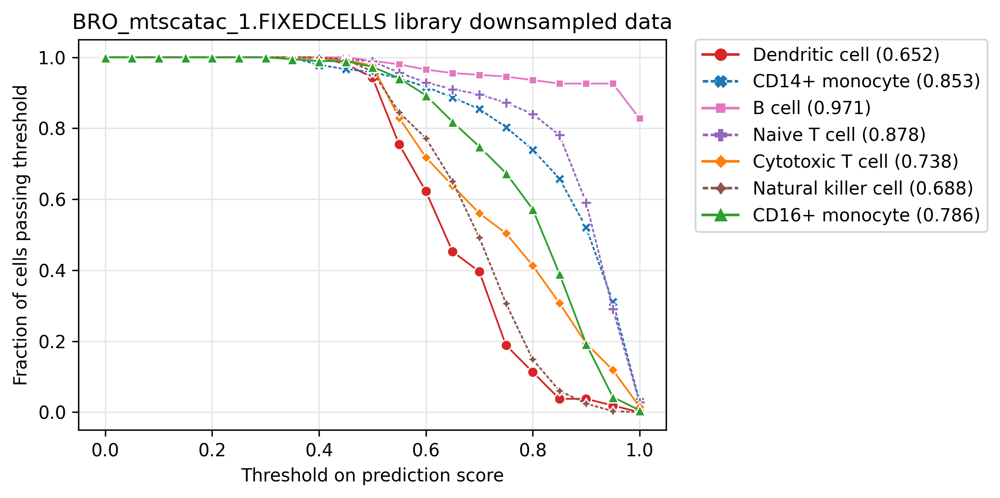

...

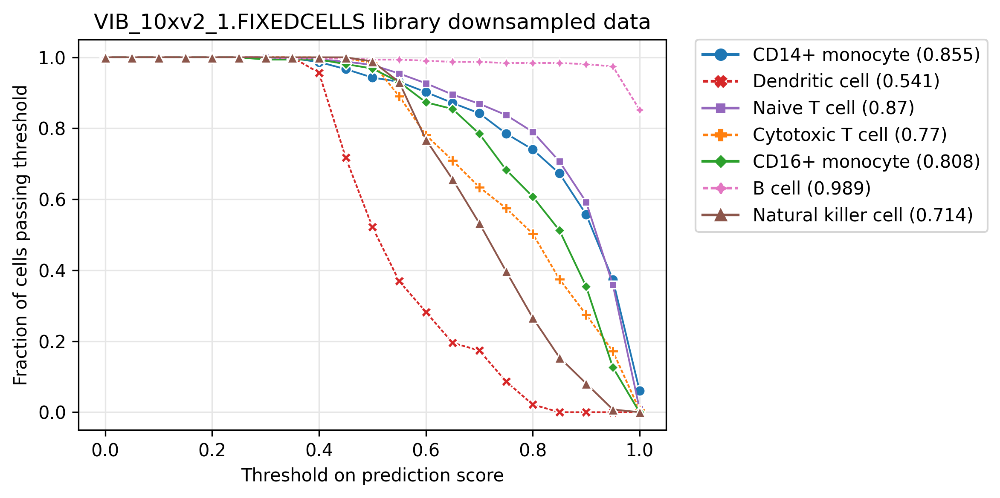

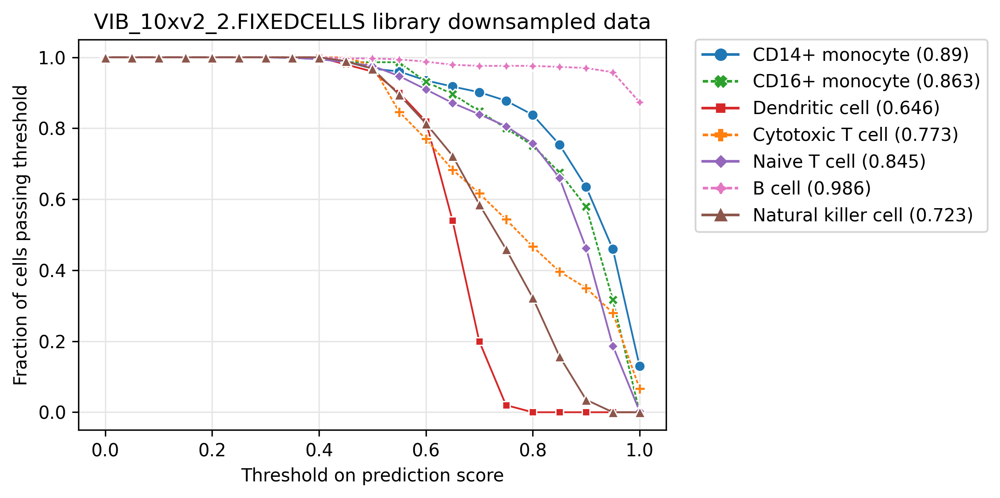

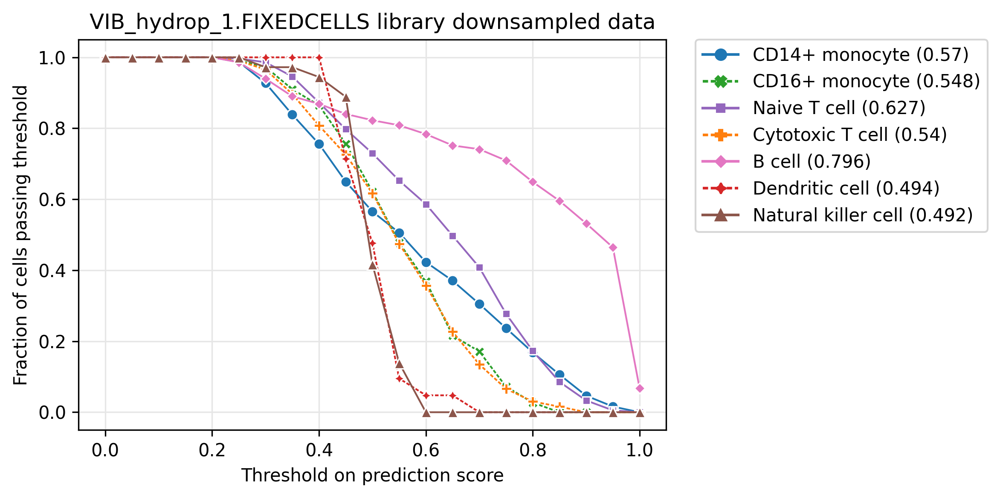

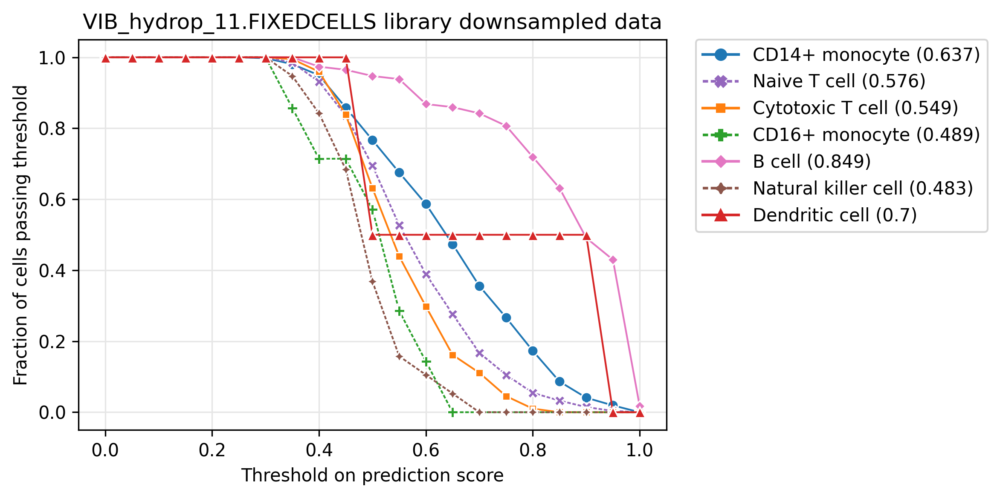

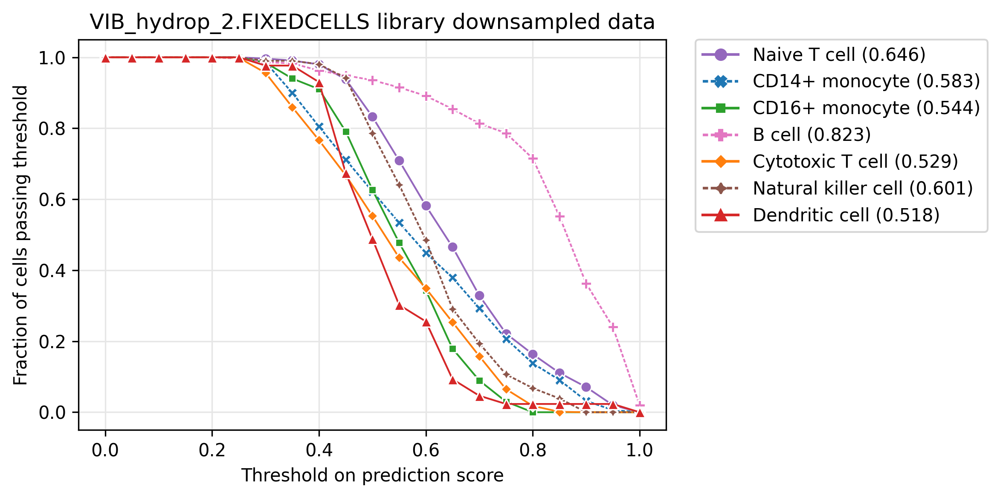

In [28]:
step = 0.05
thrs = np.arange(0,1+step,step)

for sample in ct_pred.keys():
    tmp = []
    auc = {}
    threshold_dict = {}
    df = ct_pred[sample]
    for cell_type in df['cell_type'].unique():
        df_sub = df[df['cell_type'] == cell_type]
        tmpdf = pd.DataFrame([
            thrs,
            [ sum(df_sub['cell_type_pred_score'] >= thr) for thr in thrs ],
        ]).T


        tmpdf.columns = ['Threshold', 'Score']

        tmpdf['Score'] = tmpdf['Score']/df_sub.shape[0]
        auc[cell_type] = np.trapz(tmpdf['Score'].to_numpy(), x=tmpdf['Threshold'].to_numpy() )
        tmpdf['Sample'] = f"{cell_type} ({round(auc[cell_type],3)})"
        threshold_dict[cell_type] = round(auc[cell_type],3)
        tmp.append(tmpdf)
    #break
    tp = pd.concat(tmp, ignore_index=True)
    
    cell_type_alias = {x: x.split(' (')[0] for x in sorted(tp['Sample'].unique())}
    palette_unique = {x: cell_palette[cell_type_alias[x]] for x in cell_type_alias.keys()}
    
    fig, ax = plt.subplots(1,1, figsize=(8,4), dpi=300 )
    plot_frac_cells_passing_threshold(tp, ax, title=f"{sample} library downsampled data", palette=palette_unique)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.tight_layout()
    # reorderLegend(ax, order_thr)
    # plt_pred['Libds'] = tp.copy()
    plt.savefig(f'plts_pub/{sample}_per_cell_label_transfer.png', transparent=False, bbox_inches='tight', facecolor='white', dpi=300)
    # plt.savefig(f'plts_pub/libds_label_transfer.svg', transparent=False, bbox_inches='tight', facecolor='white', dpi=300)
    plt.show()
    plt.close()


# all per cell type 

In [29]:
ct_pred_df_all = pd.DataFrame()
for sample in ct_pred.keys():
    ct_pred_df_all = pd.concat([ct_pred_df_all, ct_pred[sample]])

In [30]:
ct_pred_df_all = ct_pred_df_all.reset_index(drop=True)
ct_pred_df_all

,composite_sample_id,barcode,sample_id,cell_type,cell_type_pred_score,cell_type_hiconf_70
0,CAGGCGGATGAATAAAGTGCG_CGCGGCGACCTACCGCAGTGT-BI...,CAGGCGGATGAATAAAGTGCG_CGCGGCGACCTACCGCAGTGT,BIO_ddseq_1.FIXEDCELLS,Naive T cell,0.794101,CD4+ T cell
1,ACACGCGATATAACATTCGTT_TTCCTCTTCGTTCTGCTAATT-BI...,ACACGCGATATAACATTCGTT_TTCCTCTTCGTTCTGCTAATT,BIO_ddseq_1.FIXEDCELLS,Cytotoxic T cell,0.581627,Unknown
2,AACGGTGGAGAGGTTAGTGTT_TTGTAAGCGTTTGATGAGGAG-BI...,AACGGTGGAGAGGTTAGTGTT_TTGTAAGCGTTTGATGAGGAG,BIO_ddseq_1.FIXEDCELLS,Naive T cell,0.680369,Unknown
3,ATAGTTGTGAGATTGAATCAA-BIO_ddseq_1.FIXEDCELLS,ATAGTTGTGAGATTGAATCAA,BIO_ddseq_1.FIXEDCELLS,B cell,1.000000,B cell
4,TACGCATTCTGAACGAGCGTG-BIO_ddseq_1.FIXEDCELLS,TACGCATTCTGAACGAGCGTG,BIO_ddseq_1.FIXEDCELLS,Naive T cell,0.916906,CD4+ T cell
...,...,...,...,...,...,...
170182,GACGAGGTAAGATGGCCAAC-2-VIB_hydrop_2.FIXEDCELLS,GACGAGGTAAGATGGCCAAC-2,VIB_hydrop_2.FIXEDCELLS,Cytotoxic T cell,0.677033,Unknown
170183,AGGTTGCATTATCCGAGTAT-2-VIB_hydrop_2.FIXEDCELLS,AGGTTGCATTATCCGAGTAT-2,VIB_hydrop_2.FIXEDCELLS,Cytotoxic T cell,0.517525,Unknown
170184,TCAAGAGGCGAGGACGTTCG-2-VIB_hydrop_2.FIXEDCELLS,TCAAGAGGCGAGGACGTTCG-2,VIB_hydrop_2.FIXEDCELLS,Cytotoxic T cell,0.538525,Unknown
170185,GGAGTATTCTCAAGACGTCT-2-VIB_hydrop_2.FIXEDCELLS,GGAGTATTCTCAAGACGTCT-2,VIB_hydrop_2.FIXEDCELLS,Cytotoxic T cell,0.440256,Unknown


In [31]:
tmpdf

,Threshold,Score,Sample
0,0.00,1.000000,Dendritic cell (0.518)
1,0.05,1.000000,Dendritic cell (0.518)
2,0.10,1.000000,Dendritic cell (0.518)
3,0.15,1.000000,Dendritic cell (0.518)
4,0.20,1.000000,Dendritic cell (0.518)
5,0.25,1.000000,Dendritic cell (0.518)
6,0.30,0.976744,Dendritic cell (0.518)
7,0.35,0.976744,Dendritic cell (0.518)
8,0.40,0.930233,Dendritic cell (0.518)
9,0.45,0.674419,Dendritic cell (0.518)


In [32]:
tmp = []
for cell_type in ct_pred_df_all['cell_type'].unique():
    print(cell_type)
    df_sub = ct_pred_df_all[ct_pred_df_all['cell_type'] == cell_type]
    tmpdf = pd.DataFrame([
        thrs,
        [ sum(df_sub['cell_type_pred_score'] >= thr) for thr in thrs ],
    ]).T

    tmpdf.columns = ['Threshold', 'Score']

    tmpdf['Score'] = tmpdf['Score']/df_sub.shape[0]
    auc[cell_type] = np.trapz(tmpdf['Score'].to_numpy(), x=tmpdf['Threshold'].to_numpy() )
    tmpdf['Sample'] = f"{cell_type} ({round(auc[cell_type],3)})"
    print(f"{cell_type} ({round(auc[cell_type],3)})")
    threshold_dict[cell_type] = round(auc[cell_type],3)
    tmp.append(tmpdf)
#break
tp_all = pd.concat(tmp, ignore_index=True)

Naive T cell
Naive T cell (0.75)
Cytotoxic T cell
Cytotoxic T cell (0.639)
B cell
B cell (0.89)
Natural killer cell
Natural killer cell (0.683)
CD14+ monocyte
CD14+ monocyte (0.764)
CD16+ monocyte
CD16+ monocyte (0.726)
Dendritic cell
Dendritic cell (0.616)


In [33]:
tp_all

,Threshold,Score,Sample
0,0.00,1.000000,Naive T cell (0.75)
1,0.05,1.000000,Naive T cell (0.75)
2,0.10,1.000000,Naive T cell (0.75)
3,0.15,1.000000,Naive T cell (0.75)
4,0.20,1.000000,Naive T cell (0.75)
...,...,...,...
142,0.80,0.104651,Dendritic cell (0.616)
143,0.85,0.054264,Dendritic cell (0.616)
144,0.90,0.015504,Dendritic cell (0.616)
145,0.95,0.003876,Dendritic cell (0.616)


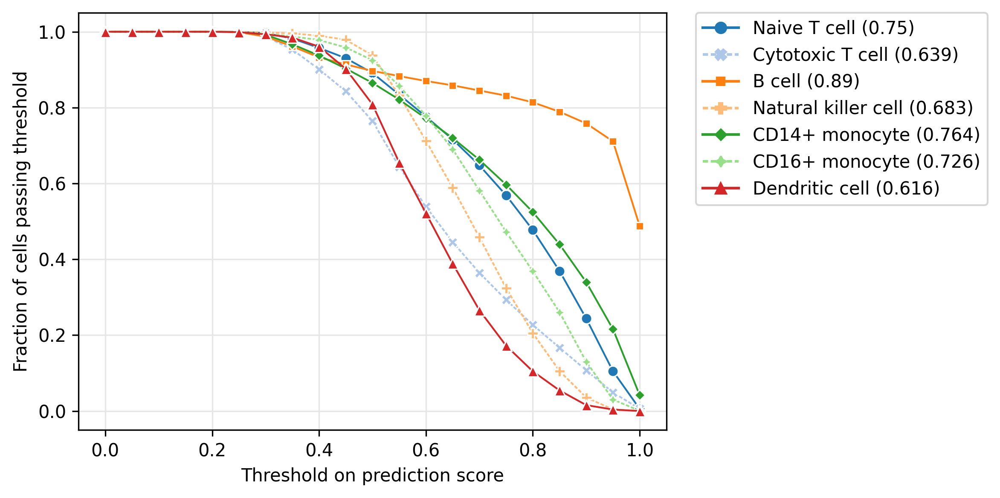

In [34]:
fig, ax = plt.subplots(1,1, figsize=(8,4), dpi=300 )
plot_frac_cells_passing_threshold(tp_all, ax)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.tight_layout()
plt.savefig('plots_pub/seurat_scores_bycelltype.png', facecolor='white', dpi=300)

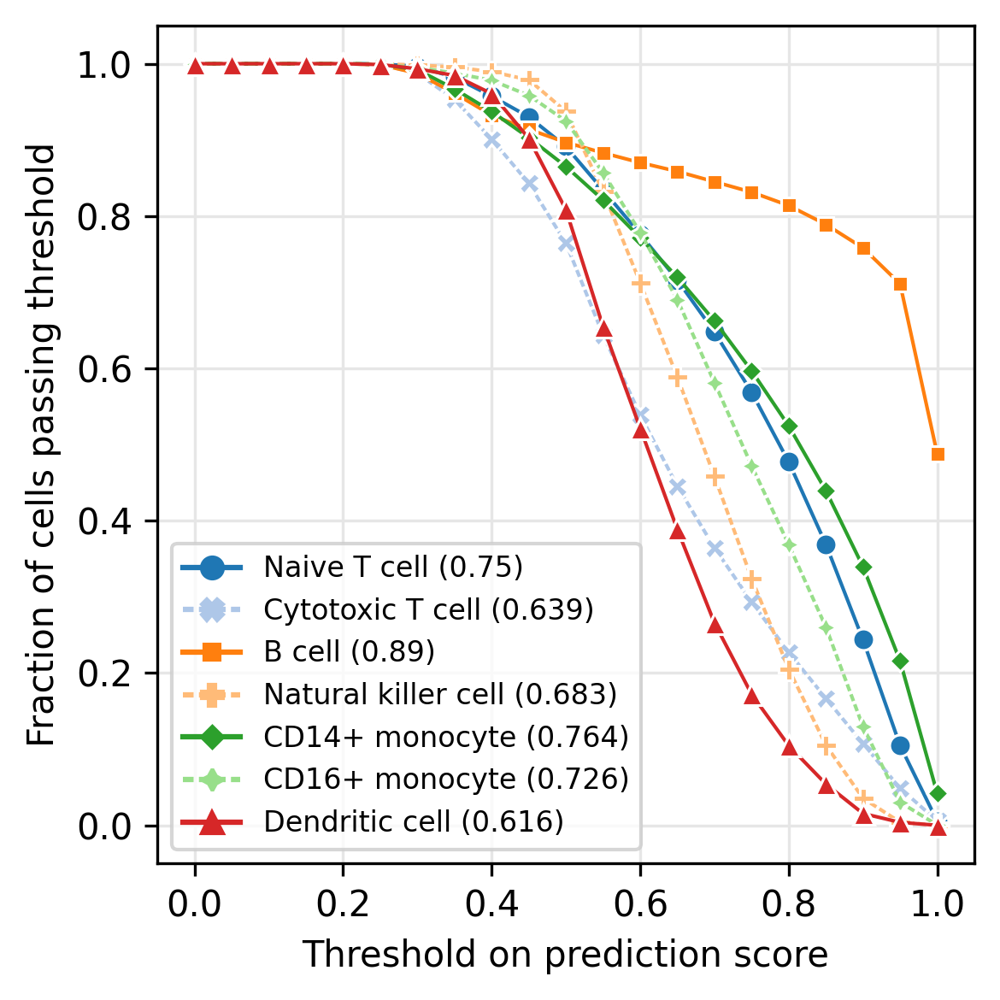

In [35]:
fig, ax = plt.subplots(1,1, figsize=(4,4), dpi=300 )
plot_frac_cells_passing_threshold(tp_all, ax)
# plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.tight_layout()
plt.savefig('plots_pub/seurat_scores_bycelltype.png', facecolor='white', dpi=300)
plt.savefig('plots_pub/seurat_scores_bycelltype.svg', facecolor='white', dpi=300)

# all per cell type per tech

In [53]:
ct_pred_df_all = pd.DataFrame()
for sample in ct_pred.keys():
    ct_pred_df_all = pd.concat([ct_pred_df_all, ct_pred[sample]])

In [55]:
ct_pred_df_all = ct_pred_df_all.reset_index(drop=True)
ct_pred_df_all

,composite_sample_id,barcode,sample_id,cell_type,cell_type_pred_score,cell_type_hiconf_70
0,CAGGCGGATGAATAAAGTGCG_CGCGGCGACCTACCGCAGTGT-BI...,CAGGCGGATGAATAAAGTGCG_CGCGGCGACCTACCGCAGTGT,BIO_ddseq_1.FIXEDCELLS,Naive T cell,0.794101,CD4+ T cell
1,ACACGCGATATAACATTCGTT_TTCCTCTTCGTTCTGCTAATT-BI...,ACACGCGATATAACATTCGTT_TTCCTCTTCGTTCTGCTAATT,BIO_ddseq_1.FIXEDCELLS,Cytotoxic T cell,0.581627,Unknown
2,AACGGTGGAGAGGTTAGTGTT_TTGTAAGCGTTTGATGAGGAG-BI...,AACGGTGGAGAGGTTAGTGTT_TTGTAAGCGTTTGATGAGGAG,BIO_ddseq_1.FIXEDCELLS,Naive T cell,0.680369,Unknown
3,ATAGTTGTGAGATTGAATCAA-BIO_ddseq_1.FIXEDCELLS,ATAGTTGTGAGATTGAATCAA,BIO_ddseq_1.FIXEDCELLS,B cell,1.000000,B cell
4,TACGCATTCTGAACGAGCGTG-BIO_ddseq_1.FIXEDCELLS,TACGCATTCTGAACGAGCGTG,BIO_ddseq_1.FIXEDCELLS,Naive T cell,0.916906,CD4+ T cell
...,...,...,...,...,...,...
170182,GACGAGGTAAGATGGCCAAC-2-VIB_hydrop_2.FIXEDCELLS,GACGAGGTAAGATGGCCAAC-2,VIB_hydrop_2.FIXEDCELLS,Cytotoxic T cell,0.677033,Unknown
170183,AGGTTGCATTATCCGAGTAT-2-VIB_hydrop_2.FIXEDCELLS,AGGTTGCATTATCCGAGTAT-2,VIB_hydrop_2.FIXEDCELLS,Cytotoxic T cell,0.517525,Unknown
170184,TCAAGAGGCGAGGACGTTCG-2-VIB_hydrop_2.FIXEDCELLS,TCAAGAGGCGAGGACGTTCG-2,VIB_hydrop_2.FIXEDCELLS,Cytotoxic T cell,0.538525,Unknown
170185,GGAGTATTCTCAAGACGTCT-2-VIB_hydrop_2.FIXEDCELLS,GGAGTATTCTCAAGACGTCT-2,VIB_hydrop_2.FIXEDCELLS,Cytotoxic T cell,0.440256,Unknown


In [71]:
ct_pred_df_all["sample_id"] = [x.replace("CNA_10xv11_4", "CNA_10xv11c_1").replace("CNA_10xv11_5", "CNA_10xv11c_2").replace("BRO_mtscatac", "BRO_mtscatacfacs") for x in ct_pred_df_all["sample_id"]]

In [72]:
ct_pred_df_all["tech"] = [x.split('_')[1] for x in ct_pred_df_all["sample_id"]]

In [75]:
tech_alias_dict = {
    "10xmultiome": "10x Multiome",
    "10xv1": "10x v1",
    "10xv11": "10x v1.1",
    "10xv11c": "10x v1.1 (control)",
    "10xv2": "10x v2",
    "ddseq": "Bio-Rad ddSEQ SureCell",
    "hydrop": "HyDrop",
    "mtscatac": "mtscATAC-seq",
    "mtscatacfacs": "mtscATAC-seq (FACS)",
    "s3atac": "s3-ATAC",
}

tech_order = [
    "10xv1",
    "10xv11",
    "10xv11c",
    "10xv2",
    "10xmultiome",
    "mtscatac",
    "mtscatacfacs",
    "ddseq",
    "s3atac",
    "hydrop",
]

In [77]:
axes

array([<AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >,
       <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >,
       <AxesSubplot: >], dtype=object)

In [84]:
fig, axes = plt.subplots(4,3, figsize=(12,16), dpi=600 )
axes = axes.flatten()
for tech in ct_pred_df_all["tech"].unique():
    tp_all = pd.DataFrame()
    tmp = []
    ax = axes[tech_order.index(tech)]
    for cell_type in ct_pred_df_all['cell_type'].unique():
        print(cell_type)
        df_sub = ct_pred_df_all[ct_pred_df_all['cell_type'] == cell_type]
        df_sub = df_sub[df_sub['tech'] == tech]
        tmpdf = pd.DataFrame([
            thrs,
            [ sum(df_sub['cell_type_pred_score'] >= thr) for thr in thrs ],
        ]).T

        tmpdf.columns = ['Threshold', 'Score']

        tmpdf['Score'] = tmpdf['Score']/df_sub.shape[0]
        auc[cell_type] = np.trapz(tmpdf['Score'].to_numpy(), x=tmpdf['Threshold'].to_numpy() )
        tmpdf['Sample'] = f"{cell_type} ({round(auc[cell_type],3)})"
        print(f"{cell_type} ({round(auc[cell_type],3)})")
        threshold_dict[cell_type] = round(auc[cell_type],3)
        tmp.append(tmpdf)
        tp_all = pd.concat(tmp, ignore_index=True)
        
    plot_frac_cells_passing_threshold(tp_all, ax)
    ax.set_title(tech_alias_dict[tech],)
    # plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    
axes[-1].remove()
axes[-2].remove()
plt.tight_layout()
plt.savefig(f'plots_pub/seurat_scores_bycelltype_alltechs.png', facecolor='white', dpi=600)
plt.savefig(f'plots_pub/seurat_scores_bycelltype_alltechs.svg', facecolor='white', dpi=600)
plt.show()


Naive T cell
Naive T cell (0.724)
Cytotoxic T cell
Cytotoxic T cell (0.629)
B cell
B cell (0.898)
Natural killer cell
Natural killer cell (0.672)
CD14+ monocyte
CD14+ monocyte (0.781)
CD16+ monocyte
CD16+ monocyte (0.69)
Dendritic cell
Dendritic cell (0.576)
Naive T cell
Naive T cell (0.855)
Cytotoxic T cell
Cytotoxic T cell (0.737)
B cell
B cell (0.971)
Natural killer cell
Natural killer cell (0.686)
CD14+ monocyte
CD14+ monocyte (0.857)
CD16+ monocyte
CD16+ monocyte (0.824)
Dendritic cell
Dendritic cell (0.684)
Naive T cell
Naive T cell (0.775)
Cytotoxic T cell
Cytotoxic T cell (0.66)
B cell
B cell (0.925)
Natural killer cell
Natural killer cell (0.684)
CD14+ monocyte
CD14+ monocyte (0.787)
CD16+ monocyte
CD16+ monocyte (0.698)
Dendritic cell
Dendritic cell (0.627)
Naive T cell
Naive T cell (0.778)
Cytotoxic T cell
Cytotoxic T cell (0.726)
B cell
B cell (0.968)
Natural killer cell
Natural killer cell (0.711)
CD14+ monocyte
CD14+ monocyte (0.775)
CD16+ monocyte
CD16+ monocyte (0.764)


### Cell type distributions

In [36]:
def calc_cell_type_dist(ct_pred, order):
    tp = pd.concat([ ct_pred[key] for key in order])
    tp_counts = tp[['sample_id','cell_type']].groupby(['sample_id','cell_type']).size().rename('counts')
    tp = tp_counts.groupby(level=0).apply(lambda x: x / x.sum() ).reset_index(name='fraction')
    return tp   

In [37]:
tp = calc_cell_type_dist(ct_pred, ct_pred.keys())

/tmp/ipykernel_175618/1405394031.py:4: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  tp = tp_counts.groupby(level=0).apply(lambda x: x / x.sum() ).reset_index(name='fraction')


In [38]:
tp['sample_id'].unique()

array(['BIO_ddseq_1.FIXEDCELLS', 'BIO_ddseq_2.FIXEDCELLS',
       'BIO_ddseq_3.FIXEDCELLS', 'BIO_ddseq_4.FIXEDCELLS',
       'BRO_mtscatac_1.FIXEDCELLS', 'BRO_mtscatac_2.FIXEDCELLS',
       'CNA_10xmultiome_1.FIXEDCELLS', 'CNA_10xmultiome_2.FIXEDCELLS',
       'CNA_10xv11_1.FIXEDCELLS', 'CNA_10xv11_2.FIXEDCELLS',
       'CNA_10xv11_3.FIXEDCELLS', 'CNA_10xv11_4.FIXEDCELLS',
       'CNA_10xv11_5.FIXEDCELLS', 'CNA_10xv2_1.FIXEDCELLS',
       'CNA_10xv2_2.FIXEDCELLS', 'CNA_hydrop_1.FIXEDCELLS',
       'CNA_hydrop_2.FIXEDCELLS', 'CNA_hydrop_3.FIXEDCELLS',
       'CNA_mtscatac_1.FIXEDCELLS', 'CNA_mtscatac_2.FIXEDCELLS',
       'EPF_hydrop_1.FIXEDCELLS', 'EPF_hydrop_2.FIXEDCELLS',
       'EPF_hydrop_3.FIXEDCELLS', 'EPF_hydrop_4.FIXEDCELLS',
       'HAR_ddseq_1.FIXEDCELLS', 'HAR_ddseq_2.FIXEDCELLS',
       'MDC_mtscatac_1.FIXEDCELLS', 'MDC_mtscatac_2.FIXEDCELLS',
       'OHS_s3atac_1.FIXEDCELLS', 'OHS_s3atac_2.FIXEDCELLS',
       'SAN_10xmultiome_1.FIXEDCELLS', 'SAN_10xmultiome_2.FIXEDCELLS',


tp['name'] = [alias_dict[x] for x in tp['sample_id']]

In [39]:
tp['name'] = tp['sample_id']

In [40]:
def plot_cell_type_dist(tp, ax, title="", leg_size=7, leg_on=True, palette='tab20', order=None):
    g = sns.barplot(data=tp,
        x="cell_type", y="fraction", hue="name", hue_order=order,
        palette=palette, alpha=1,# height=6,
        ax=ax
    )
    ax.set_xlabel('')
    ax.set_ylabel('Fraction of cells')
    g.set_xticklabels(g.get_xticklabels(), rotation=15, ha='right', fontsize=8)
    #plt.legend(bbox_to_anchor=(1.025, 1), loc=2, borderaxespad=0., fontsize=8)
    ax.grid(color='0.9', axis='y')
    ax.legend(loc=0, fontsize=leg_size)
    ax.set_title(title, fontsize=8)
    return g

In [41]:
tp['tech'] = [x.split('_')[1] for x in tp['sample_id']]

ddseq


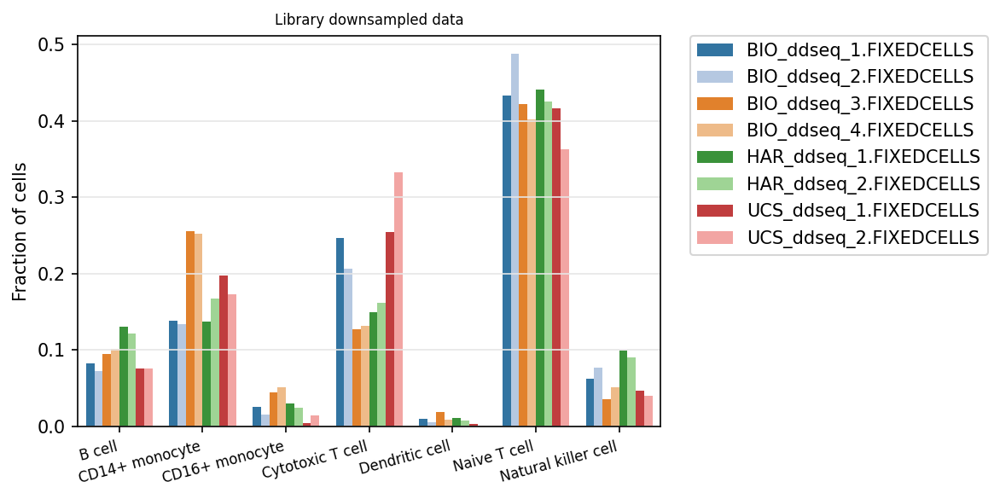

mtscatac


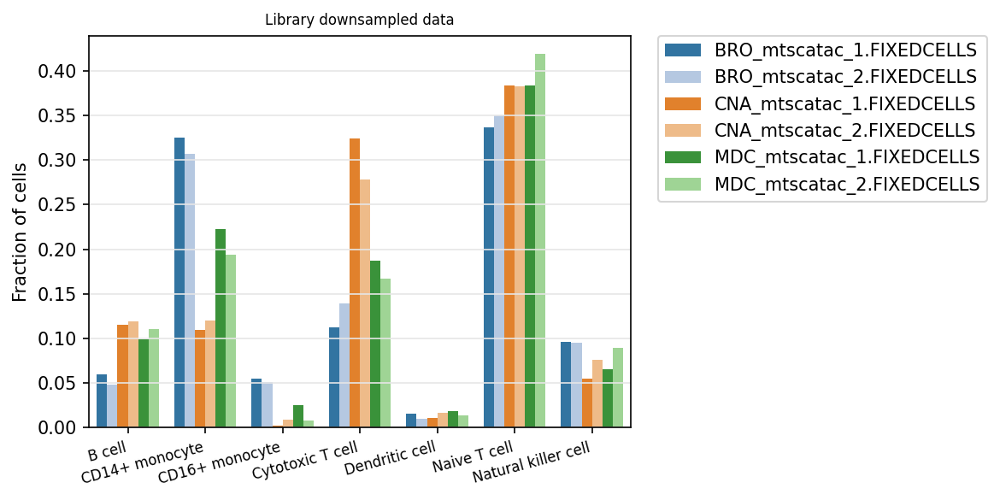

10xmultiome


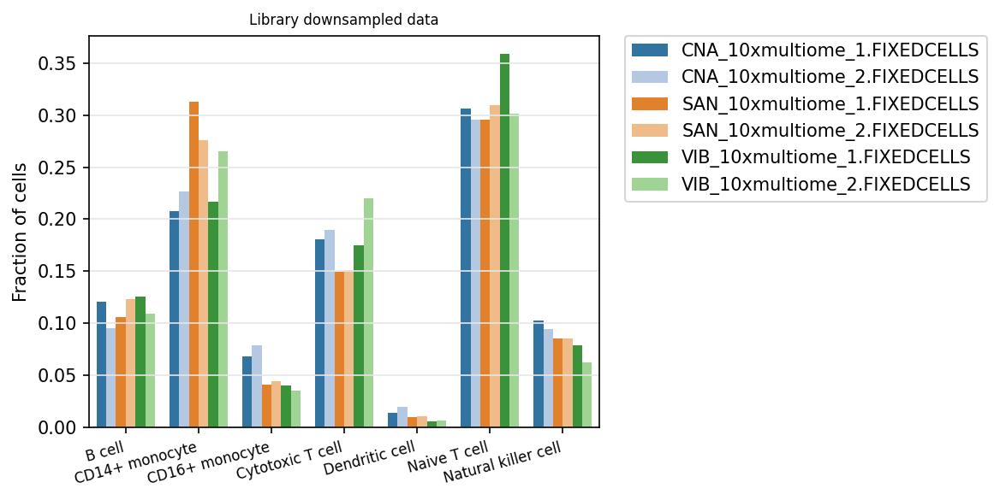

10xv11


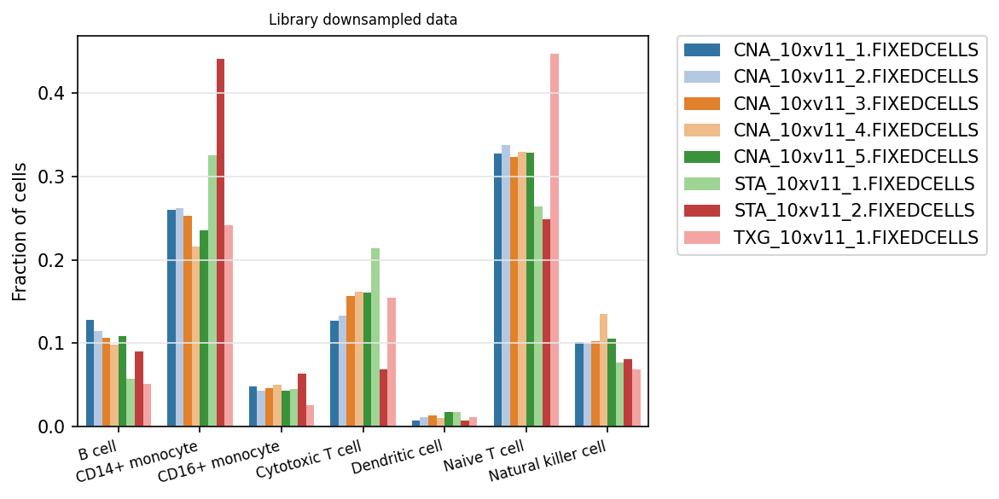

10xv2


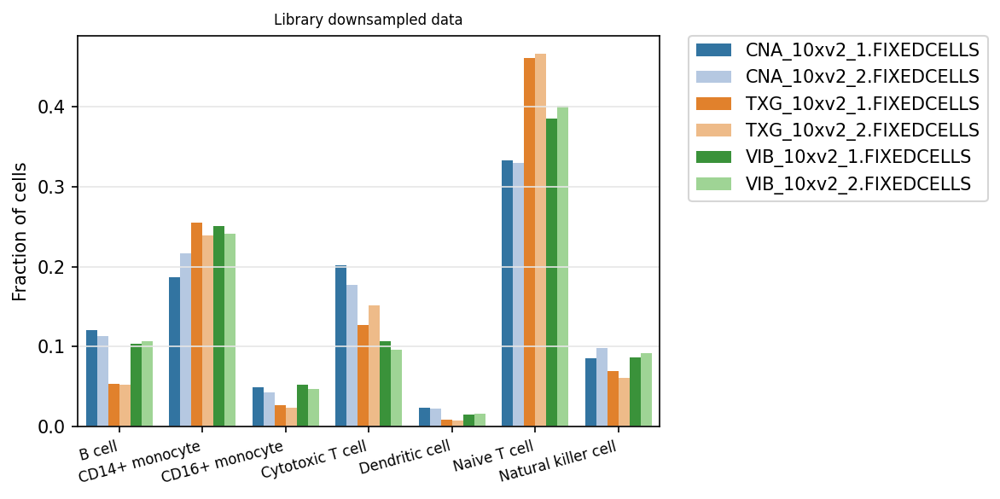

hydrop


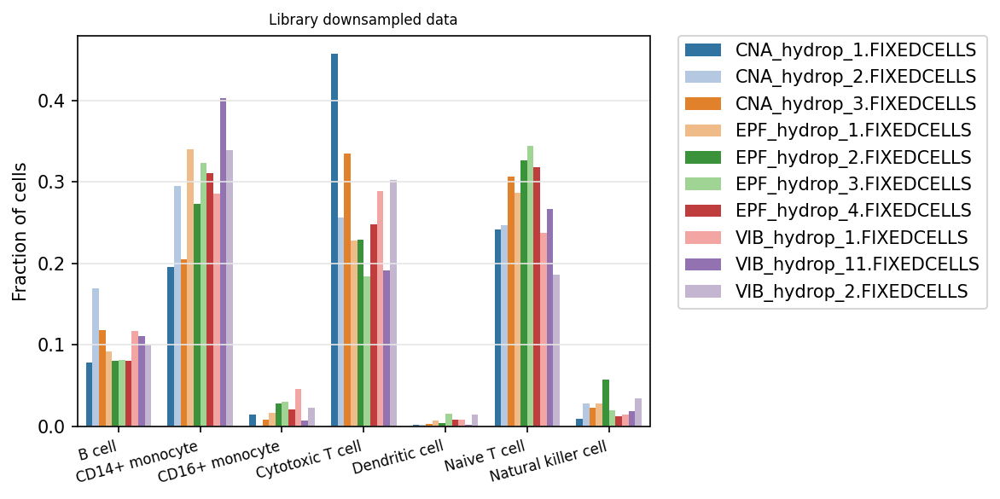

s3atac


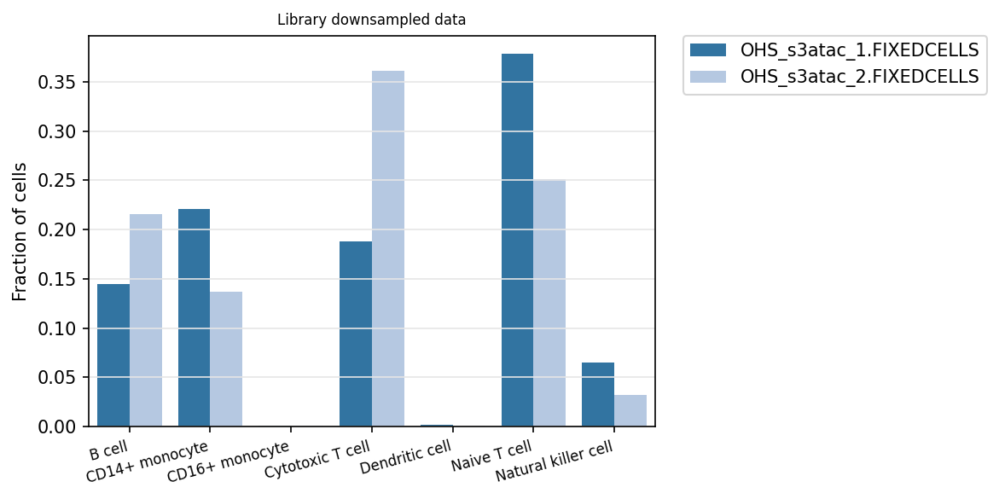

10xv1


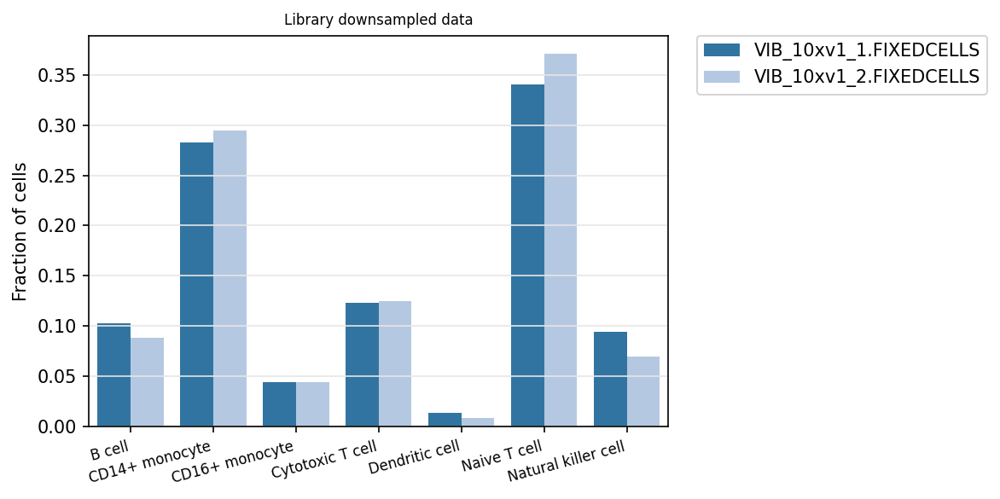

In [42]:
for tech in tp['tech'].unique():
    print(tech)
    tp_sub = tp[tp['tech'] == tech]
    
    fig, ax = plt.subplots(1,1, figsize=(8,4), dpi=150 )
    
    plot_cell_type_dist(tp_sub, ax, title="Library downsampled data")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

    plt.tight_layout()
    plt.savefig(f'plots_qc/libds_cell_distribution__{tech}.png', transparent=False, bbox_inches='tight', facecolor='white')
    plt.show()
    plt.close()
    # plt.savefig(f'plts_pub/libds_cell_distribution.svg', transparent=False, bbox_inches='tight')

/tmp/ipykernel_175618/4062228201.py:5: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


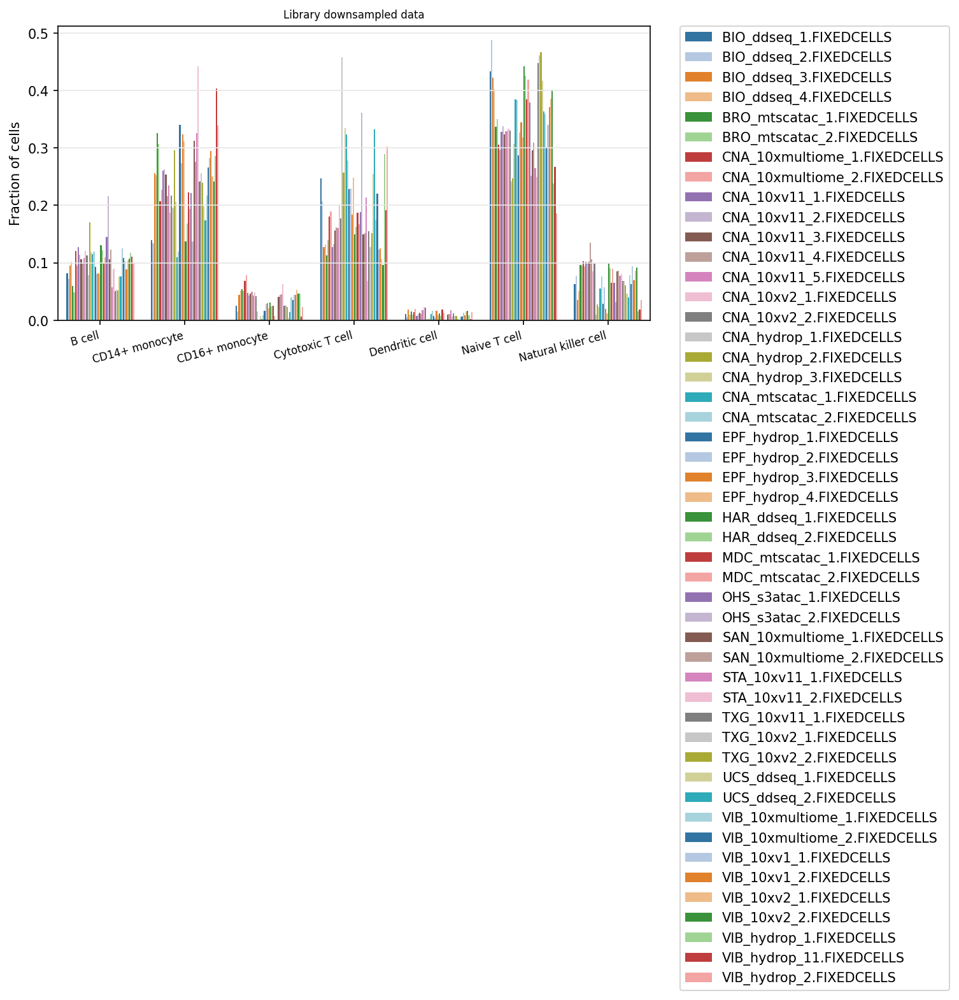

In [43]:
fig, ax = plt.subplots(1,1, figsize=(8,4), dpi=150 )
plot_cell_type_dist(tp, ax, title="Library downsampled data", order=sorted(ct_pred.keys()))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.tight_layout()
# plt.savefig(f'plts_pub/libds_cell_distribution.png', transparent=False, bbox_inches='tight')
# plt.savefig(f'plts_pub/libds_cell_distribution.svg', transparent=False, bbox_inches='tight')

/tmp/ipykernel_175618/4062228201.py:5: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


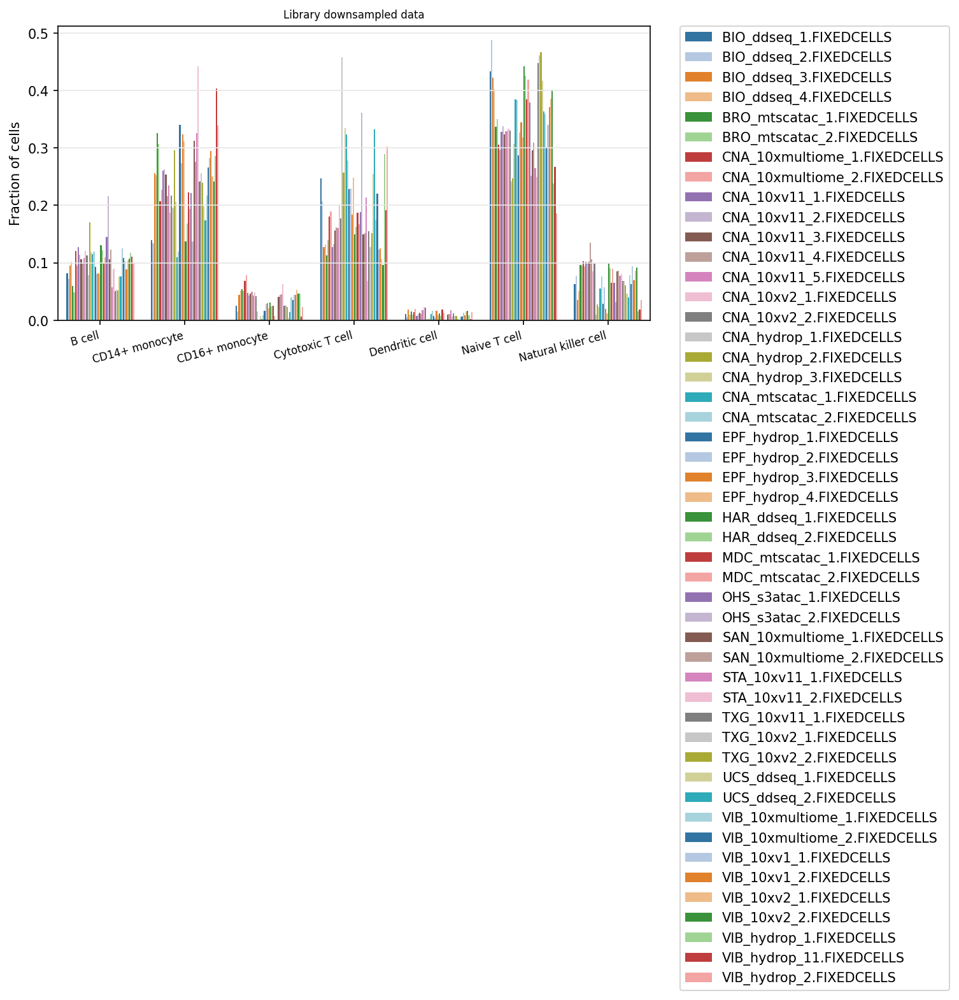

In [44]:
fig, ax = plt.subplots(1,1, figsize=(8,4), dpi=150 )
plot_cell_type_dist(tp, ax, title="Library downsampled data", order=sorted(ct_pred.keys()))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.tight_layout()
# plt.savefig(f'plts_pub/libds_cell_distribution.png', transparent=False, bbox_inches='tight')
# plt.savefig(f'plts_pub/libds_cell_distribution.svg', transparent=False, bbox_inches='tight')

# Make these stacked

In [45]:
order = [
    "VIB_10xv1_1.FIXEDCELLS",
    "VIB_10xv1_2.FIXEDCELLS",
    "CNA_10xv11_1.FIXEDCELLS",
    "CNA_10xv11_2.FIXEDCELLS",
    "CNA_10xv11_3.FIXEDCELLS",
    "CNA_10xv11_4.FIXEDCELLS",
    "CNA_10xv11_5.FIXEDCELLS",
    "STA_10xv11_1.FIXEDCELLS",
    "STA_10xv11_2.FIXEDCELLS",
    "TXG_10xv11_1.FIXEDCELLS",
    "CNA_10xv2_1.FIXEDCELLS",
    "CNA_10xv2_2.FIXEDCELLS",
    "TXG_10xv2_1.FIXEDCELLS",
    "TXG_10xv2_2.FIXEDCELLS",
    "VIB_10xv2_1.FIXEDCELLS",
    "VIB_10xv2_2.FIXEDCELLS",
    "CNA_10xmultiome_1.FIXEDCELLS",
    "CNA_10xmultiome_2.FIXEDCELLS",
    "SAN_10xmultiome_1.FIXEDCELLS",
    "SAN_10xmultiome_2.FIXEDCELLS",
    "VIB_10xmultiome_1.FIXEDCELLS",
    "VIB_10xmultiome_2.FIXEDCELLS",
    "BRO_mtscatac_1.FIXEDCELLS",
    "BRO_mtscatac_2.FIXEDCELLS",
    "CNA_mtscatac_1.FIXEDCELLS",
    "CNA_mtscatac_2.FIXEDCELLS",
    "MDC_mtscatac_1.FIXEDCELLS",
    "MDC_mtscatac_2.FIXEDCELLS",
    "BIO_ddseq_1.FIXEDCELLS",
    "BIO_ddseq_2.FIXEDCELLS",
    "BIO_ddseq_3.FIXEDCELLS",
    "BIO_ddseq_4.FIXEDCELLS",
    "HAR_ddseq_1.FIXEDCELLS",
    "HAR_ddseq_2.FIXEDCELLS",
    "UCS_ddseq_1.FIXEDCELLS",
    "UCS_ddseq_2.FIXEDCELLS",
    "CNA_hydrop_1.FIXEDCELLS",
    "CNA_hydrop_2.FIXEDCELLS",
    "CNA_hydrop_3.FIXEDCELLS",
    "EPF_hydrop_1.FIXEDCELLS",
    "EPF_hydrop_2.FIXEDCELLS",
    "EPF_hydrop_3.FIXEDCELLS",
    "EPF_hydrop_4.FIXEDCELLS",
    "VIB_hydrop_1.FIXEDCELLS",
    "VIB_hydrop_2.FIXEDCELLS",
    "OHS_s3atac_1.FIXEDCELLS",
    "OHS_s3atac_2.FIXEDCELLS",
]

In [46]:
tp_pivot = tp.pivot(index="sample_id", columns="cell_type", values="fraction").loc[order]

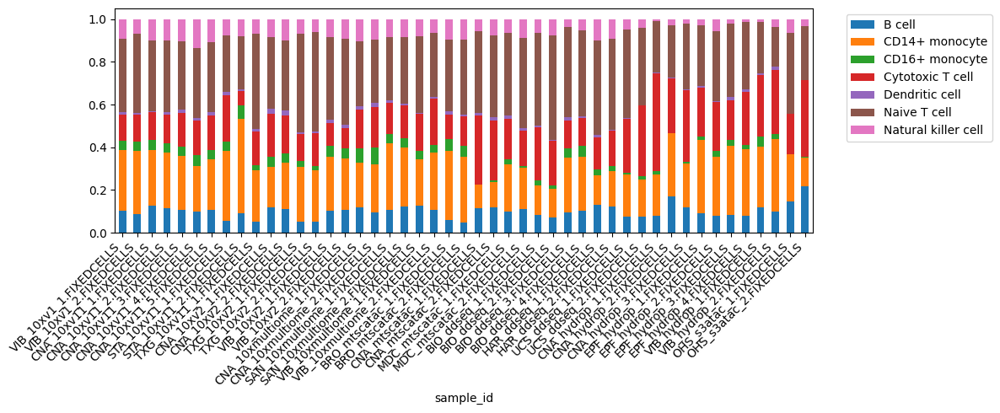

In [47]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(1, 1)
fig.set_figheight(5)
fig.set_figwidth(12)

tp_pivot.plot(kind='bar', stacked=True, ax=axes)
plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.savefig("plots_pub/seurat_celltypes.png", dpi=300, facecolor='white')

In [48]:
tp_pivot['tech'] = [x.split('_')[1] for x in tp_pivot.index]

In [49]:
tp_pivot_bytech = tp_pivot.groupby('tech').sum()
tp_pivot_bytech = tp_pivot_bytech.div(tp_pivot_bytech.sum(axis=1), axis=0)

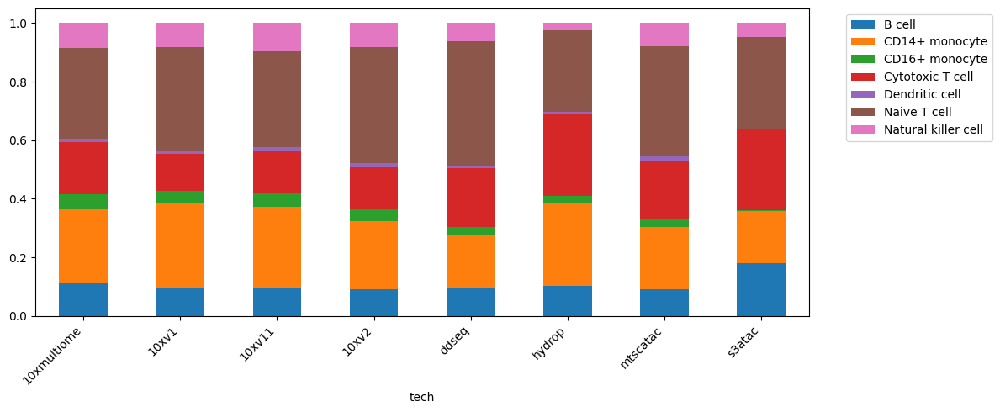

In [50]:
fig, axes = plt.subplots(1, 1)
fig.set_figheight(5)
fig.set_figwidth(12)

tp_pivot_bytech.plot(kind='bar', stacked=True, ax=axes)
plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig("plots_pub/seurat_celltypes_bytech.png", dpi=300, facecolor='white')

In [51]:
tp_pivot_bytech.sum(axis=1)

tech
10xmultiome    1.0
10xv1          1.0
10xv11         1.0
10xv2          1.0
ddseq          1.0
hydrop         1.0
mtscatac       1.0
s3atac         1.0
dtype: float64

In [52]:
tp_pivot_bytech

cell_type,B cell,CD14+ monocyte,CD16+ monocyte,Cytotoxic T cell,Dendritic cell,Naive T cell,Natural killer cell
tech,,,,,,,
10xmultiome,0.113351,0.250905,0.051156,0.177626,0.011047,0.311136,0.084779
10xv1,0.095664,0.288594,0.044200,0.123772,0.010761,0.355397,0.081611
10xv11,0.094147,0.279499,0.045351,0.146920,0.011879,0.326001,0.096203
10xv2,0.091644,0.231665,0.039867,0.143401,0.015390,0.396333,0.081699
ddseq,0.094605,0.182137,0.026353,0.201462,0.008394,0.424209,0.062839
hydrop,0.102214,0.285612,0.020820,0.281232,0.007443,0.277346,0.025334
mtscatac,0.091673,0.212883,0.024673,0.201298,0.013879,0.376253,0.079343
s3atac,0.180458,0.179060,0.000893,0.274923,0.001215,0.314906,0.048544
